In [3]:
"""A simple python script template."""
import argparse
import os
import shutil
import sys
from collections import defaultdict
from typing import Dict, Optional

import matplotlib.animation as anim
import matplotlib.lines as mlines
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.interpolate as interp

from argoverse.map_representation.cargoversemap_api import CargoverseMap

import pdb
from argoverse.data_loading.argoverse_forecasting_loader import ArgoverseForecastingLoader

##set root_dir to the correct path to your dataset folder
root_dir = '../../LaneGCN/dataset/val/data_cargo/'
afl = ArgoverseForecastingLoader(root_dir)

# Town03_xml_root = anaconda3/envs/lanegcn/lib/python3.7/site-packages/map_files/
 

def viz_centerline(
    city_name: str,
    lane_centerlines: Optional[np.ndarray] = None,
    show: bool = True,
) -> None:
    
    if lane_centerlines is None:
        # Get API for Argo Dataset map
        cavm = CargoverseMap()
        seq_lane_props = cavm.city_lane_centerlines_dict[city_name]
        lane_centerlines = []
        polies =[]
        # Get lane centerlines which lie within the range of trajectories
        for lane_id, lane_props in seq_lane_props.items():
            lane_cl = lane_props.centerline
            lane_centerlines.append(lane_cl)
            try:
                poly = cavm.get_lane_segment_polygon_2d(lane_id, city_name) # width omit
                polies.append(poly)
            except Exception as e:
                print(e)
            
    plt.figure(figsize=(20, 15))
    
    for lane_cl in lane_centerlines:
        plt.plot(
        lane_cl[:, 0],
        -lane_cl[:, 1],
        "--",
        color="grey",
        alpha=1,
        linewidth=1,
        zorder=0,
        )   
    for poly in polies:
        plt.plot(
        poly[:, 0],
        -poly[:, 1],
        "--",
        color="yellow",
        alpha=1,
        linewidth=1,
        zorder=0,
        )   
    print(len(lane_centerlines))
    print(len(polies))
    plt.axis("off")
    if show:
        plt.show()


In [4]:
# viz_centerline('MIA', show=True)
# viz_centerline('PIT', show=True)

Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.
Shape of array too 

/home/jongwon/anaconda3/envs/lanegcn/lib/python3.7/site-packages/argoverse/utils/centerline_utils.py:71: RuntimeWarning: divide by zero encountered in true_divide
  inv_slopes = -1.0 / slopes


400
376


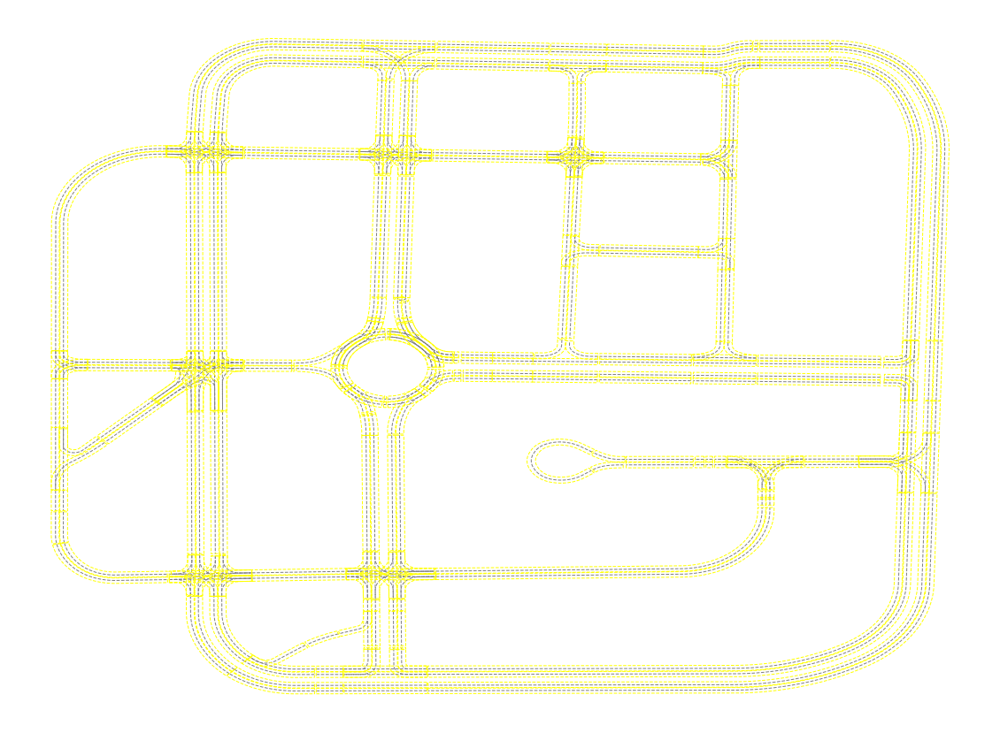

In [5]:
############################ GOAL ############################

viz_centerline('T03', show=True)

##############################################################

In [2]:
import torch
a = torch.load("cargoverse_results.pkl")
b = torch.load("results.pkl")

In [3]:
a.keys()

dict_keys(['preds', 'gts', 'cities'])

In [4]:
b['preds'].keys()


dict_keys([36003, 39942, 1125, 39582, 29221, 34738, 4605, 227, 39738, 9242, 20071, 32829, 17438, 1959, 11572, 8037, 9856, 3340, 39270, 2160, 21973, 16281, 11101, 27880, 17047, 13165, 11182, 37726, 38960, 25415, 40269, 8100, 25748, 26882, 17947, 7241, 15040, 2265, 21596, 34843, 26856, 27121, 22011, 23655, 7275, 41087, 3730, 2487, 41123, 40056, 1577, 9699, 20218, 8681, 2606, 24955, 35416, 34480, 24461, 34613, 30154, 27392, 2179, 15899, 10925, 9000, 11264, 3605, 9824, 32654, 29013, 6493, 19356, 16773, 13253, 20906, 19665, 786, 7219, 12200, 32257, 8206, 16524, 12987, 29194, 14687, 8094, 4352, 24257, 9512, 17138, 10685, 15846, 19036, 11790, 26731, 11522, 3953, 1509, 7452, 5902, 16471, 7733, 10363, 14544, 7903, 32966, 26877, 33473, 9047, 2312, 7228, 22239, 11795, 18349, 16473, 11301, 35317, 30480, 16515, 30143, 11761, 32881, 40570, 17298, 24068, 4902, 35771, 4667, 34067, 12656, 6067, 24278, 34981, 14157, 33462, 28705, 5054, 11779, 31407, 21722, 7975, 23505, 22470, 12711, 4671, 35017, 38768, 

In [54]:
b['preds'][6867].shape

(6, 30, 2)

In [6]:
def get_cmap(n, name='hsv'):
    '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
    RGB color; the keyword argument name must be a standard mpl colormap name.'''
    return plt.cm.get_cmap(name, n)

_ZORDER = {"AGENT": 15, "AV": 10, "OTHERS": 5}
def viz_sequence(
    df: pd.DataFrame,
    pred_sequence = None, #(M, 6, 30, 2)
    show_k = 0, # [-1, 5]
    lane_centerlines: Optional[np.ndarray] = None,
    show: bool = True,
    smoothen: bool = False,
) -> None:

    # Seq data
    time_list = np.sort(np.unique(df["TIMESTAMP"].values))
    city_name = df["CITY_NAME"].values[0]

    if lane_centerlines is None:
        # Get API for Argo Dataset map
        cavm = CargoverseMap()
        seq_lane_bbox = cavm.city_halluc_bbox_table[city_name]
        seq_lane_props = cavm.city_lane_centerlines_dict[city_name]

    plt.figure(0, figsize=(20, 15))

    x_min = min(df["X"])
    x_max = max(df["X"])
    y_min = min(df["Y"])
    y_max = max(df["Y"])
    
    print(x_max - x_min, y_max - y_min)
    
    frames = df.groupby("TRACK_ID")
    for group_name, group_data in frames:
        object_type = group_data["OBJECT_TYPE"].values[0]
        if object_type == 'AV':
            cor_x = group_data["X"].values
            cor_y = group_data["Y"].values
            break
    
    if lane_centerlines is None:

        plt.xlim(x_min, x_max)
        plt.ylim(y_min, y_max)

        lane_props = []
        
        radius = 30
        lane_ids = cavm.get_lane_ids_in_xy_bbox(cor_x[-1], cor_y[-1],
                                               city_name, radius)
        
#         for lane_id in lane_ids:
#             lane_props.append(seq_lane_props[lane_id])
        
        # Get lane centerlines which lie within the range of trajectories
        for lane_id, lane_prop in seq_lane_props.items():
#             print(lane_prop.__dict__)
            lane_cl = lane_prop.centerline
            if (
                np.min(lane_cl[:, 0]) < x_max
                and np.min(lane_cl[:, 1]) < y_max
                and np.max(lane_cl[:, 0]) > x_min
                and np.max(lane_cl[:, 1]) > y_min
            ):
                lane_props.append(lane_prop)
    
    for lane_prop in lane_props:
        lane_cl = lane_prop.centerline
        plt.plot(
            lane_cl[:, 0],
            lane_cl[:, 1],
            "--",
            color="grey",
            alpha=1,
            linewidth=1,
            zorder=0,
        )
            

    plt.xlabel("Map X")
    plt.ylabel("Map Y")

    color_dict = {"AGENT": "#d33e4c", "OTHERS": "#d3e8ef", "AV": "#007672"}
    object_type_tracker: Dict[int, int] = defaultdict(int)

    # Plot predicted as blue ()
    if pred_sequence is not None:
        if show_k != -1:
            for m, pred in enumerate(pred_sequence): #(M, 6, 30, 2)
#                 if m == 10 or m == 17:
                pred = pred[show_k] 
                cor_x = pred[:, 0]
                cor_y = pred[:, 1]

                plt.plot(
                    cor_x,
                    cor_y,
                    "--",
                    color='yellow',
                    alpha=1,
                    linewidth=1,
                    zorder= 16,
                )
        else:
            cmap = get_cmap(6)
            print(len(pred_sequence))
            for k in range(6):
                for m, pred in enumerate(pred_sequence): #(M, 6, 30, 2)
                    if m == 10 or m == 22:
                        print(k, m, pred[k])
                        pred = pred[k] 
                        cor_x = pred[:, 0]
                        cor_y = pred[:, 1]

                        plt.plot(
                            cor_x,
                            cor_y,
                            "--",
                            color=cmap(k),
                            alpha=1,
                            linewidth=1,
                            zorder= 16,
                        )
        
        
    # Plot all the tracks up till current frame
    for group_name, group_data in frames:
        object_type = group_data["OBJECT_TYPE"].values[0]

        cor_x = group_data["X"].values
        cor_y = group_data["Y"].values
        
        if pred_sequence is not None and len(cor_x) == 50:
            plt.plot(
                cor_x[:20],
                cor_y[:20],
                "-",
                color=color_dict[object_type],
                label=object_type if not object_type_tracker[object_type] else "",
                alpha=1,
                linewidth=3,
                zorder=_ZORDER[object_type],
            )
            plt.plot(
                cor_x[20:],
                cor_y[20:],
                "--",
                color=color_dict[object_type],
                label=object_type if not object_type_tracker[object_type] else "",
                alpha=1,
                linewidth=3,
                zorder=_ZORDER[object_type],
            )
        else:
            plt.plot(
                cor_x,
                cor_y,
                "--",
                color=color_dict[object_type],
                label=object_type if not object_type_tracker[object_type] else "",
                alpha=1,
                linewidth=2,
                zorder=_ZORDER[object_type],
            )
            
        final_x = cor_x[-1]
        final_y = cor_y[-1]

        if object_type == "AGENT":
            marker_type = "o"
            marker_size = 7
        elif object_type == "OTHERS":
            marker_type = "o"
            marker_size = 7
        elif object_type == "AV":
            marker_type = "o"
            marker_size = 7

        plt.plot(
            final_x,
            final_y,
            marker_type,
            color=color_dict[object_type],
            label=object_type if not object_type_tracker[object_type] else "",
            alpha=1,
            markersize=marker_size,
            zorder=_ZORDER[object_type],
        )

        object_type_tracker[object_type] += 1

    plt.axis("off")
    if show:
        plt.show()


In [7]:
seq_path = f"{root_dir}/5904.csv"
viz_sequence(afl.get(seq_path).seq_df, pred_sequence = b['preds'][5904], 
             show_k = -1, show=True)
# seq_path = f"{root_dir}/3828.csv"
# viz_sequence(afl.get(seq_path).seq_df, show=True)
# seq_path = f"{root_dir}/3700.csv"
# viz_sequence(afl.get(seq_path).seq_df, show=True)
# seq_path = f"{root_dir}/4791.csv"
# viz_sequence(afl.get(seq_path).seq_df, show=True)
# seq_path = f"{root_dir}/3861.csv"
# viz_sequence(afl.get(seq_path).seq_df, show=True)

FileNotFoundError: [Errno 2] No such file or directory: '/home/jongwon/Desktop/CARLA_benchmark_project/argoverse-api/demo_usage/../../LaneGCN/dataset/val/data_cargo/5904.csv'

In [113]:
afl.get(seq_path).seq_df

,TIMESTAMP,TRACK_ID,OBJECT_TYPE,X,Y,CITY_NAME
0,3.159706e+08,00000000-0000-0000-0000-000000000000,AV,1652.894382,393.463828,PIT
1,3.159706e+08,00000000-0000-0000-0000-000000036211,OTHERS,1665.059178,408.739859,PIT
2,3.159706e+08,00000000-0000-0000-0000-000000036215,OTHERS,1660.017101,404.947239,PIT
3,3.159706e+08,00000000-0000-0000-0000-000000036349,OTHERS,1701.430629,435.687552,PIT
4,3.159706e+08,00000000-0000-0000-0000-000000035879,OTHERS,1644.863752,387.073765,PIT
...,...,...,...,...,...,...
1033,3.159706e+08,00000000-0000-0000-0000-000000036194,OTHERS,1671.331450,414.117633,PIT
1034,3.159706e+08,00000000-0000-0000-0000-000000036230,OTHERS,1650.157547,396.592374,PIT
1035,3.159706e+08,00000000-0000-0000-0000-000000036255,OTHERS,1635.463662,378.877987,PIT
1036,3.159706e+08,00000000-0000-0000-0000-000000036360,OTHERS,1678.536497,416.890312,PIT


In [8]:
import pickle
cargo_dir = '../../LaneGCN/dataset/val/data_cargo/'


In [9]:
# for i in range(2, 16, 2):
#     print(i)
#     pred_dir = cargo_dir+str(i)+"_pred.txt"
#     with open(pred_dir, "rb") as fp:
#         pred = pickle.load(fp)
#     seq_path = f"{cargo_dir}/{str(i)}.csv"
#     viz_sequence(afl.get(seq_path).seq_df, pred_sequence = pred, 
#                  show_k = -1, show=True)


137.49426651000977 96.9025421142578


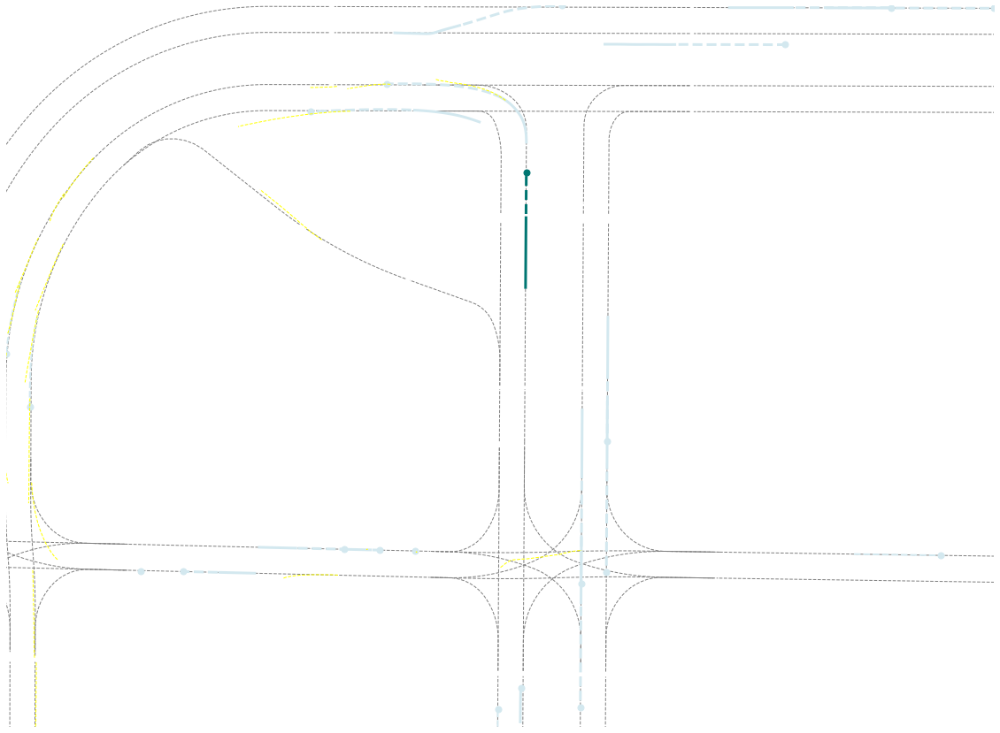

In [10]:
# pred_dir = cargo_dir+"../"+str(i)+"_pred.txt"
# with open(pred_dir, "rb") as fp:
#     pred = pickle.load(fp)
pred = np.load("4_result.npy")

seq_path = "../../LaneGCN/dataset/val/data_cargo/4.csv"

viz_sequence(afl.get(seq_path).seq_df, pred_sequence = pred, 
             show_k = 1, show=True)

In [45]:
pred.shape

(25, 6, 30, 2)

In [42]:
import torch.nn as nn
import torch
feat = torch.load("4_actor_feature.pkl")


In [44]:
feat.shape

torch.Size([25, 128])

In [9]:
m = nn.Softmax()

In [10]:
feat = m(feat)

/home/jongwon/anaconda3/envs/lanegcn/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  """Entry point for launching an IPython kernel.


In [11]:
feat[0]

tensor([0.0056, 0.0055, 0.0060, 0.0055, 0.0055, 0.0055, 0.0058, 0.0055, 0.0055,
        0.0055, 0.0073, 0.0080, 0.0096, 0.0221, 0.0055, 0.0070, 0.0055, 0.0057,
        0.0055, 0.0075, 0.0080, 0.0055, 0.0055, 0.0105, 0.0055, 0.0055, 0.0055,
        0.0069, 0.0055, 0.0055, 0.0063, 0.0055, 0.0070, 0.0055, 0.0055, 0.0461,
        0.0055, 0.0055, 0.0074, 0.0382, 0.0055, 0.0055, 0.0055, 0.0055, 0.0063,
        0.0058, 0.0277, 0.0055, 0.0067, 0.0091, 0.0057, 0.0080, 0.0067, 0.0055,
        0.0085, 0.0055, 0.0055, 0.0063, 0.0075, 0.0055, 0.0093, 0.0055, 0.0055,
        0.0055, 0.0055, 0.0055, 0.0064, 0.0055, 0.0055, 0.0055, 0.0055, 0.0089,
        0.0055, 0.0055, 0.0055, 0.0055, 0.0055, 0.0055, 0.0055, 0.0055, 0.0117,
        0.0055, 0.0055, 0.0075, 0.0106, 0.0101, 0.0128, 0.0055, 0.0055, 0.0059,
        0.0077, 0.0179, 0.0055, 0.0055, 0.0055, 0.0055, 0.0055, 0.0057, 0.0055,
        0.0521, 0.0099, 0.0147, 0.0110, 0.0055, 0.0055, 0.0055, 0.0055, 0.0055,
        0.0055, 0.0064, 0.0055, 0.0072, 

In [12]:
feat_heat = torch.matmul(feat, feat.T).cpu().numpy()

In [21]:
feat_heat

array([[0.01389369, 0.00787694, 0.01659678, 0.00787314, 0.01232544,
        0.01755475, 0.03563203, 0.00790652, 0.00764396, 0.01737581,
        0.03760744, 0.02158249, 0.00808783, 0.00789737, 0.00956337,
        0.01200768, 0.01158588, 0.03426039, 0.01683582, 0.02931109,
        0.00912933, 0.00596979, 0.03773251, 0.01548793, 0.02825489],
       [0.00787694, 0.0082229 , 0.00788428, 0.00823629, 0.0078619 ,
        0.00752845, 0.0077743 , 0.00819549, 0.00757867, 0.00736893,
        0.00755096, 0.00786504, 0.00766353, 0.0080816 , 0.00795356,
        0.00781641, 0.00791258, 0.00781147, 0.00788281, 0.00786372,
        0.00808623, 0.00755425, 0.00763119, 0.00751941, 0.00755099],
       [0.01659678, 0.00788428, 0.03987426, 0.0079246 , 0.01827348,
        0.05506223, 0.03137465, 0.0078967 , 0.02059082, 0.0585718 ,
        0.03316548, 0.02008766, 0.01904413, 0.0076806 , 0.01740422,
        0.01560455, 0.01210163, 0.02974319, 0.01620408, 0.02592241,
        0.01425346, 0.00630988, 0.03295171, 0.

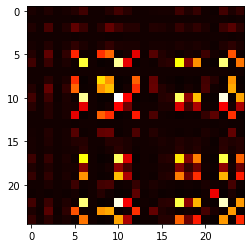

In [14]:
plt.imshow(feat_heat, cmap='hot', interpolation='nearest')
plt.show()

In [26]:
pred = np.load("4_result.npy")

In [27]:
pred.shape

(25, 6, 30, 2)

In [46]:
pred[10][0]

array([[-74.543495, 143.56992 ],
       [-74.50369 , 143.0921  ],
       [-74.47295 , 142.60254 ],
       [-74.43527 , 142.12589 ],
       [-74.389404, 141.65286 ],
       [-74.34748 , 141.17906 ],
       [-74.29422 , 140.71695 ],
       [-74.250275, 140.2683  ],
       [-74.190796, 139.81772 ],
       [-74.13921 , 139.37753 ],
       [-74.08221 , 138.94661 ],
       [-74.03405 , 138.52682 ],
       [-73.99128 , 138.0989  ],
       [-73.93469 , 137.69609 ],
       [-73.8913  , 137.293   ],
       [-73.83661 , 136.88947 ],
       [-73.78414 , 136.4942  ],
       [-73.74386 , 136.0987  ],
       [-73.70191 , 135.71144 ],
       [-73.66242 , 135.32178 ],
       [-73.625786, 134.93169 ],
       [-73.59318 , 134.54538 ],
       [-73.56269 , 134.16995 ],
       [-73.53114 , 133.7865  ],
       [-73.504616, 133.40092 ],
       [-73.474365, 133.01756 ],
       [-73.456696, 132.63608 ],
       [-73.43843 , 132.25278 ],
       [-73.42617 , 131.87907 ],
       [-73.42558 , 131.47234 ]], dtype=flo

In [47]:
pred[22][0]

array([[-74.774506, 154.9413  ],
       [-74.79065 , 154.45297 ],
       [-74.805214, 153.97603 ],
       [-74.811005, 153.48541 ],
       [-74.822426, 152.99638 ],
       [-74.83667 , 152.51012 ],
       [-74.84122 , 152.03476 ],
       [-74.85971 , 151.5476  ],
       [-74.86629 , 151.05746 ],
       [-74.87967 , 150.58257 ],
       [-74.87494 , 150.13028 ],
       [-74.88171 , 149.66374 ],
       [-74.89187 , 149.1916  ],
       [-74.891266, 148.73805 ],
       [-74.883484, 148.30336 ],
       [-74.88856 , 147.85127 ],
       [-74.89133 , 147.42564 ],
       [-74.88257 , 146.9845  ],
       [-74.880844, 146.55746 ],
       [-74.89333 , 146.13353 ],
       [-74.89237 , 145.72185 ],
       [-74.885605, 145.32005 ],
       [-74.88026 , 144.94044 ],
       [-74.87513 , 144.54636 ],
       [-74.87407 , 144.15184 ],
       [-74.86552 , 143.77826 ],
       [-74.84607 , 143.42114 ],
       [-74.83698 , 143.05324 ],
       [-74.81443 , 142.6975  ],
       [-74.80048 , 142.33476 ]], dtype=flo

In [29]:
pred.shape

(25, 6, 30, 2)

In [6]:
### Explore Lane Segment ###

city_name = 'T03'  #'MIA', 'PIT'
 
# Get API for Argo Dataset map
cavm = CargoverseMap()
seq_lane_props = cavm.city_lane_centerlines_dict['T03']
lane_centerlines = []
# Get lane centerlines which lie within the range of trajectories
for lane_id, lane_props in seq_lane_props.items():
    lane_cl = lane_props.centerline
    lane_centerlines.append(lane_cl)

import math
def L2_dist(a, b):
    return math.sqrt(((a[0] - b[0]) ** 2 + (a[1] - b[1]) ** 2))

ls_len = []
ls_len_meter = []
for i in range(len(lane_centerlines)):
    ls = lane_centerlines[i]
    ls_len.append(len(ls))
    ls_len_meter.append(L2_dist(ls[0], ls[-1]))
    
print('Average lane segment')
print("# nodes: ", sum(ls_len)/len(ls_len))
print("meters: ", sum(ls_len_meter)/len(ls_len_meter))



Average lane segment
# nodes:  69.395
meters:  31.29908766653098


(array([220., 142.,  11.,  11.,   4.,   3.,   1.,   4.,   0.,   4.]),
 array([  0.        ,  25.943937  ,  51.887874  ,  77.831811  ,
        103.775748  , 129.719685  , 155.663622  , 181.60755899,
        207.55149599, 233.49543299, 259.43936999]),
 <BarContainer object of 10 artists>)

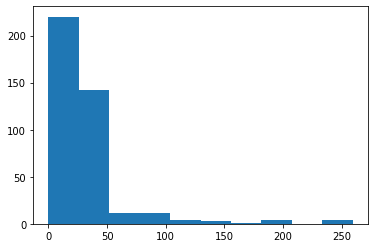

In [7]:
# Histogram of Lane Segment Length!
plt.hist(ls_len_meter)

(array([250., 117.,  13.,   8.,   0.,   4.,   0.,   4.,   0.,   4.]),
 array([  1. ,  63.1, 125.2, 187.3, 249.4, 311.5, 373.6, 435.7, 497.8,
        559.9, 622. ]),
 <BarContainer object of 10 artists>)

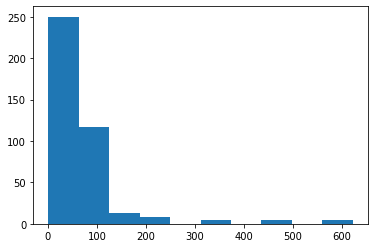

In [8]:
# Histogram of # node Lane Segment!
plt.hist(ls_len)

In [79]:
a =[1, 2, 3]
a.remove(4)

print(a)

ValueError: list.remove(x): x not in list

## Using map_api

Getting candidate centerlines for the agent's trajectory is a simple function call. Below we use the first 2 secs of the trajectory to compute candidate centerlines for the next 3 secs.

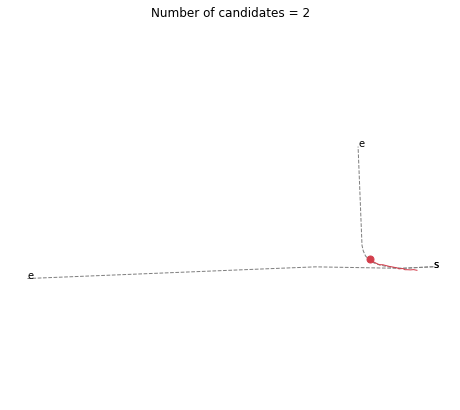

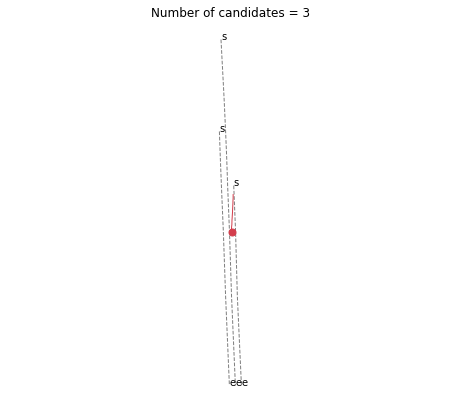

In [22]:
from argoverse.map_representation.map_api import ArgoverseMap

avm = ArgoverseMap()

obs_len = 20

index = 2
seq_path = afl.seq_list[index]
agent_obs_traj = afl.get(seq_path).agent_traj[:obs_len]
candidate_centerlines = avm.get_candidate_centerlines_for_traj(agent_obs_traj, afl[index].city, viz=True)

index = 3
seq_path = afl.seq_list[index]
agent_obs_traj = afl.get(seq_path).agent_traj[:obs_len]
candidate_centerlines = avm.get_candidate_centerlines_for_traj(agent_obs_traj, afl[index].city, viz=True)

So is getting the lane direction of the trajectory's coordinates.

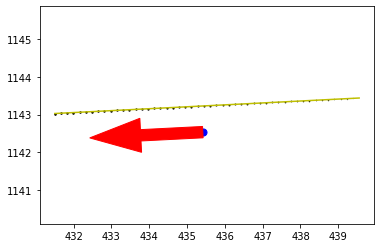

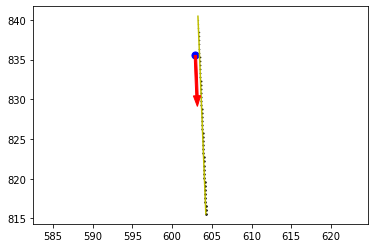

In [23]:
index = 2
seq_path = afl.seq_list[index]
agent_traj = afl.get(seq_path).agent_traj
lane_direction = avm.get_lane_direction(agent_traj[0], afl[index].city, visualize=True)

index = 3
seq_path = afl.seq_list[index]
agent_traj = afl.get(seq_path).agent_traj
lane_direction = avm.get_lane_direction(agent_traj[0], afl[index].city, visualize=True)

In [20]:
### Explore Lane Segment ###

# Get API for Argo Dataset map
cavm = CargoverseMap()
seq_lane_props = cavm.city_lane_centerlines_dict['T03']
lane_props=[]
lane_centerlines = []


# Get lane centerlines which lie within the range of trajectories
for lane_id, lane_prop in seq_lane_props.items():
    lane_cl = lane_prop.centerline
    lane_centerlines.append(lane_cl)
    lane_props.append(lane_prop)
    
    


In [21]:
# predecessor / successor

stack_laneid = []
suc_laneid = []
for lane_prop in lane_props:
    if lane_prop.id in suc_laneid:
        continue
    stack_laneid.append(lane_prop.id)
    while ( len(stack_laneid) !=0 and len(set(suc_laneid)) < len(lane_props)):
        laneid = stack_laneid.pop()
        lane_cl = seq_lane_props[laneid].centerline
        suc_laneid.append(laneid)
        
        if seq_lane_props[laneid].successors == None:
            continue
        for suc_id in seq_lane_props[laneid].successors:
            if suc_id in suc_laneid:
                continue
            stack_laneid.append(suc_id)

#         if seq_lane_props[laneid].predecessors == None:
#             continue
#         for suc_id in seq_lane_props[laneid].predecessors:
#             if suc_id in suc_laneid:
#                 continue
#             stack_laneid.append(suc_id)
            


In [25]:
len(seq_lane_props.keys())

400

930001
ln id:  930002
None


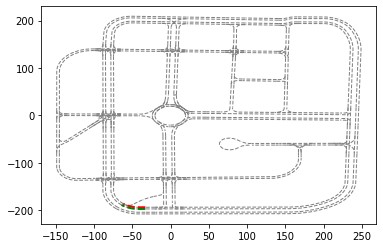

930115
ln id:  930116
None


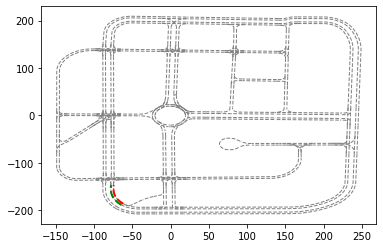

930354
None
None


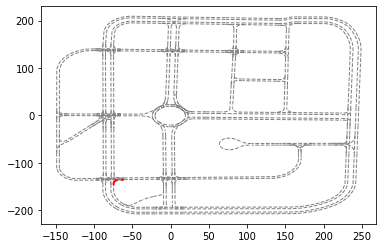

930250
None
None


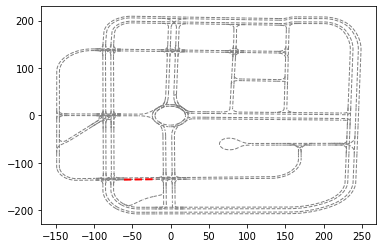

930319
None
None


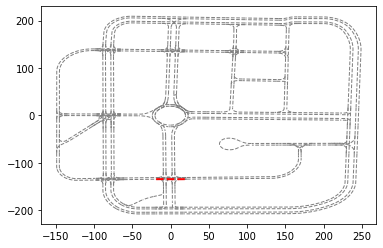

930100
None
None


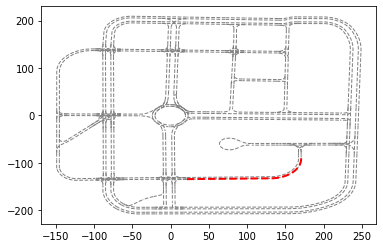

930098
None
None


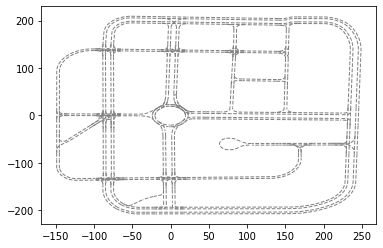

930095
None
None


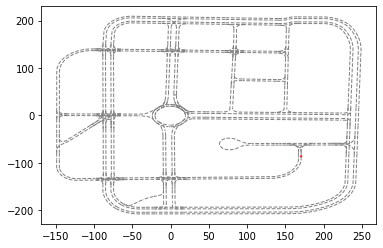

930093
None
None


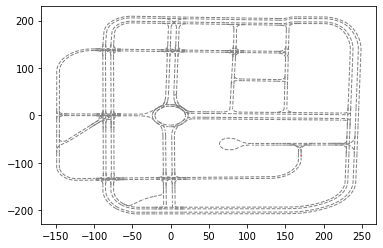

930091
None
None


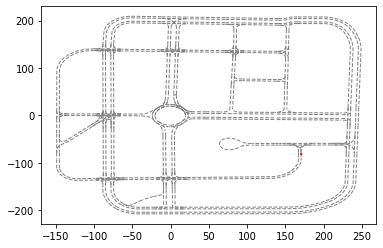

930156
None
None


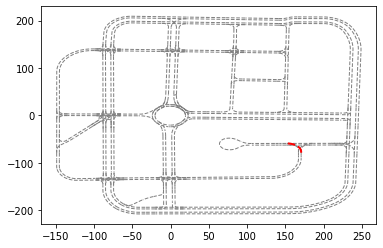

930169
None
None


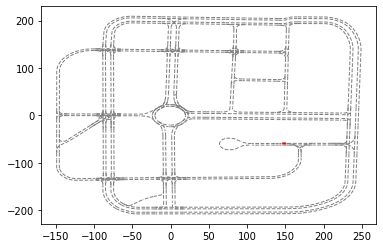

930163
None
None


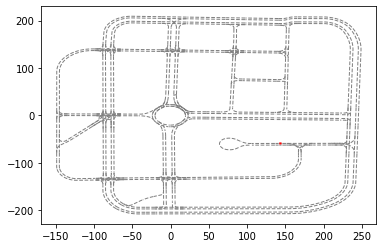

930161
None
None


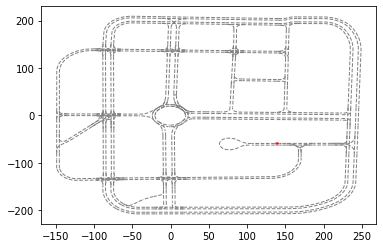

930159
None
None


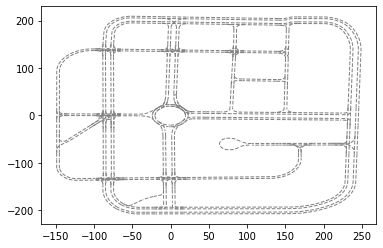

930157
None
None


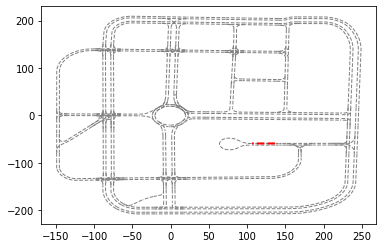

930030
None
None


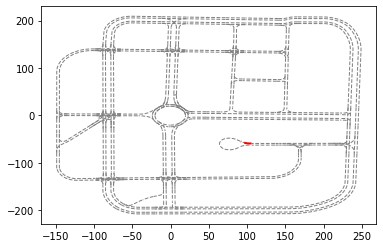

930089
None
None


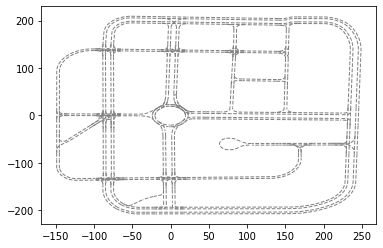

930143
None
None


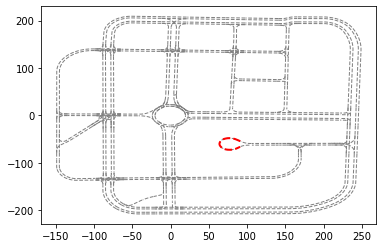

930337
None
None


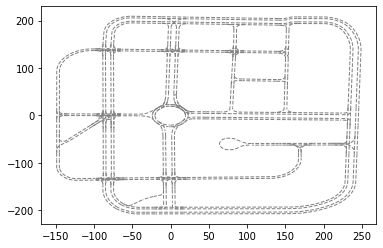

930029
None
None


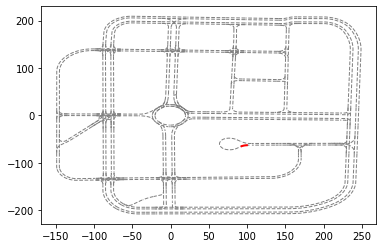

930158
None
None


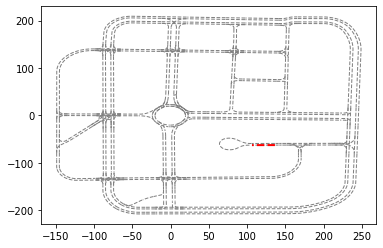

930160
None
None


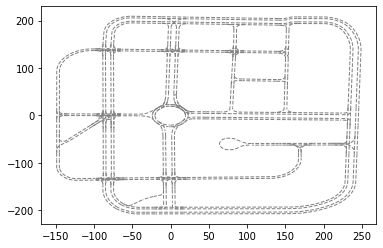

930162
None
None


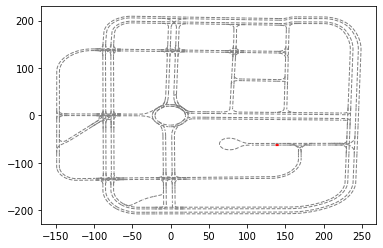

930164
None
None


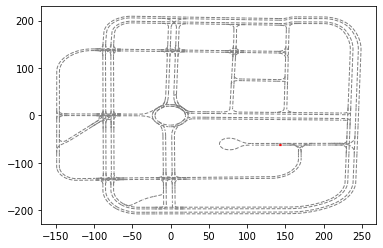

930170
None
None


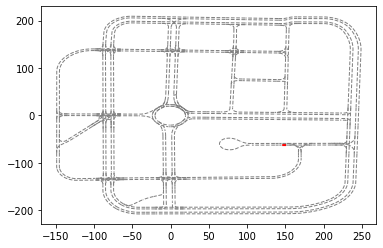

930152
None
None


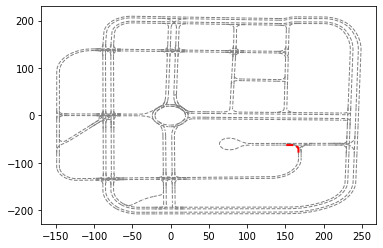

930092
None
None


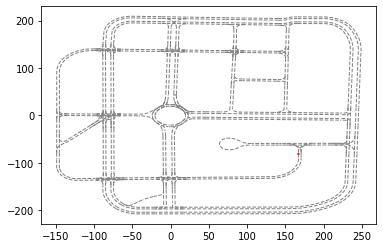

930094
None
None


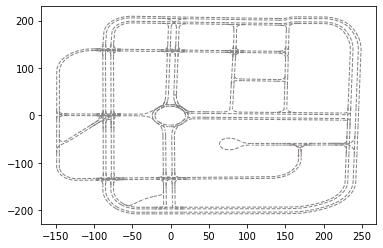

930096
None
None


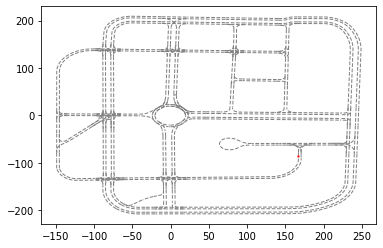

930099
None
None


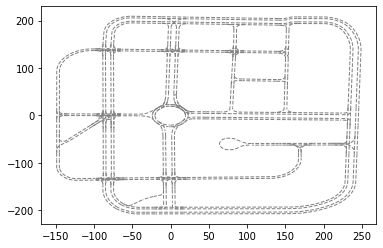

930101
None
None


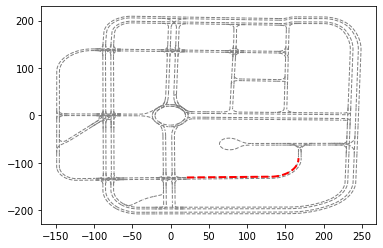

930271
None
None


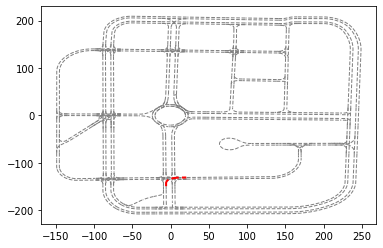

930283
None
rn id:  930282


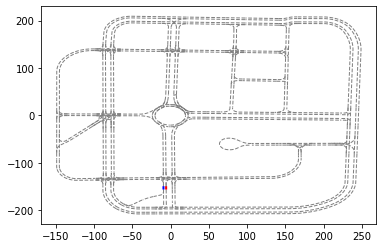

930253
None
rn id:  930252


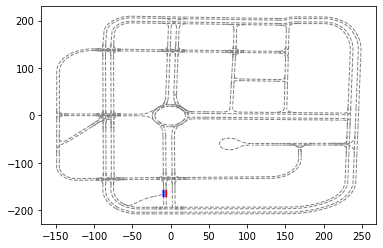

930287
None
rn id:  930286


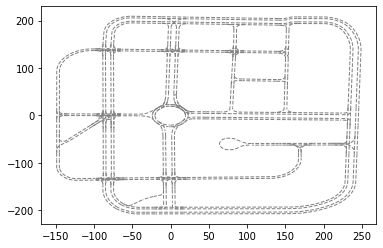

930333
None
rn id:  930332


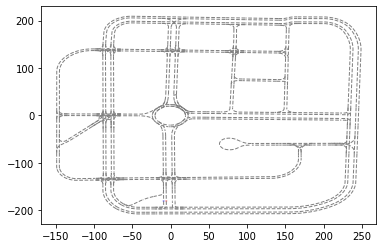

930085
None
None


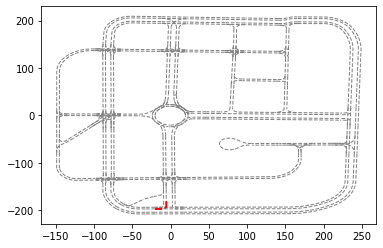

930120
None
rn id:  930119


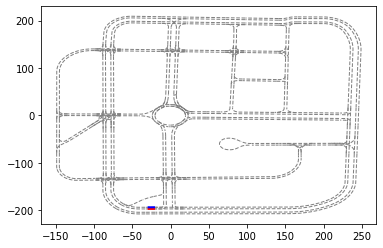

930002
None
rn id:  930001


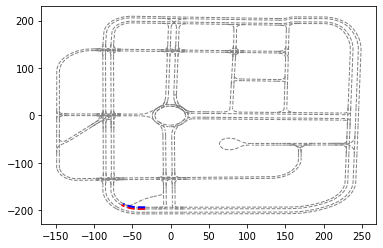

930116
None
rn id:  930115


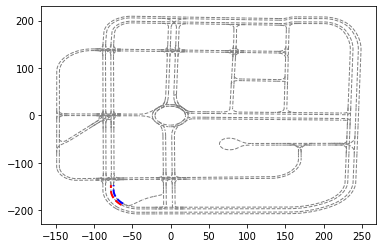

930352
None
None


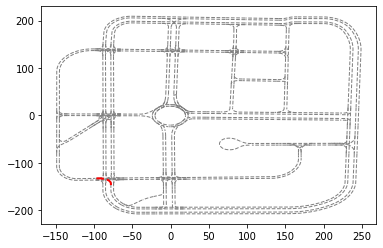

930246
None
None


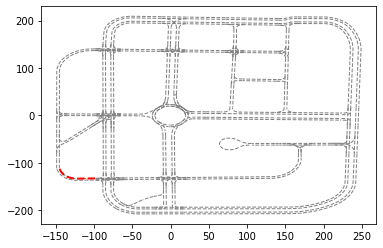

930321
None
None


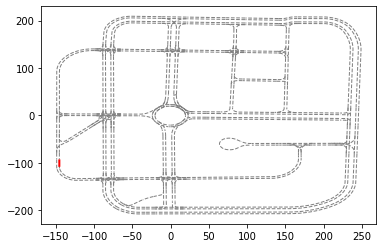

930175
None
None


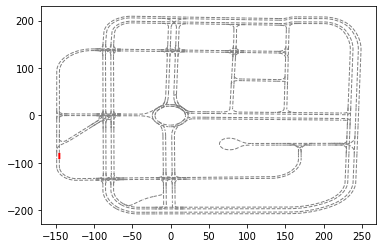

930006
None
None


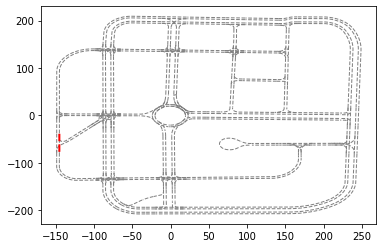

930177
None
None


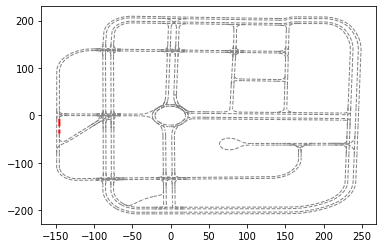

930061
None
None


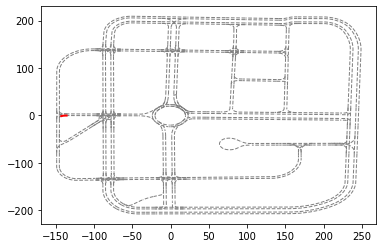

930139
None
None


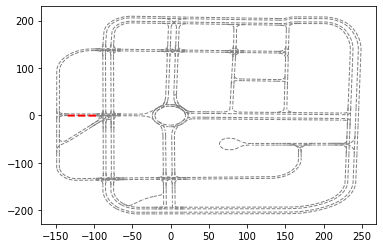

930067
None
None


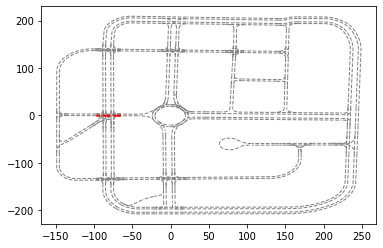

930142
None
None


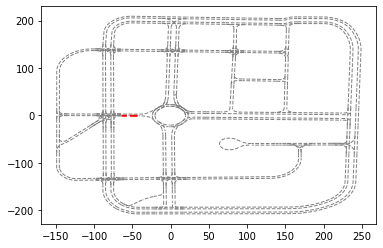

930024
None
rn id:  930023


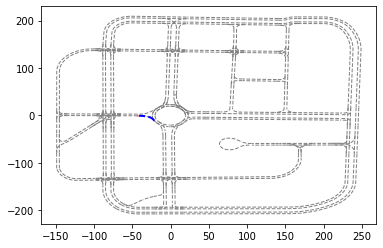

930072
None
None


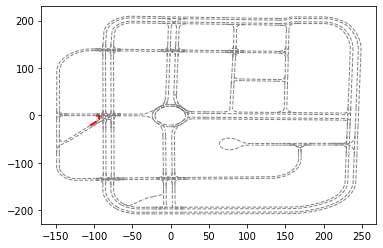

930330
ln id:  930331
None


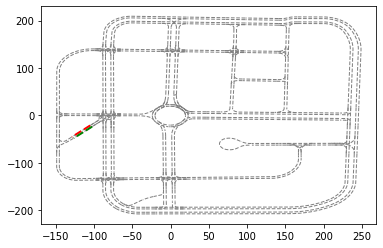

930004
None
None


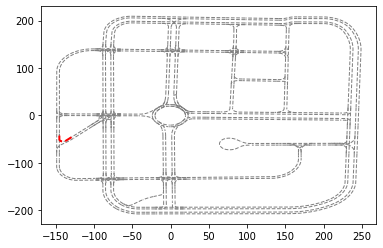

930075
None
None


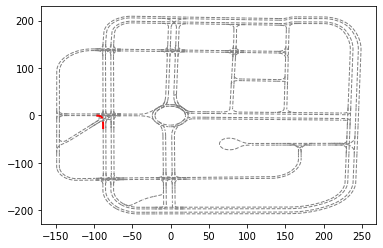

930258
ln id:  930259
None


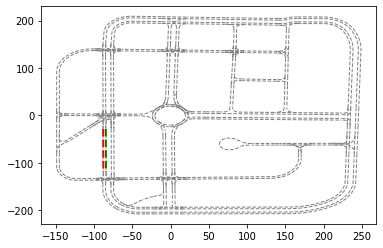

930347
None
None


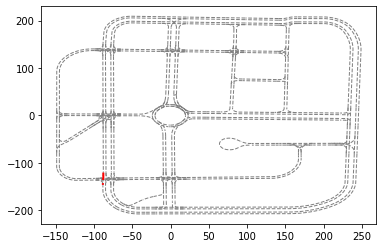

930118
ln id:  930117
None


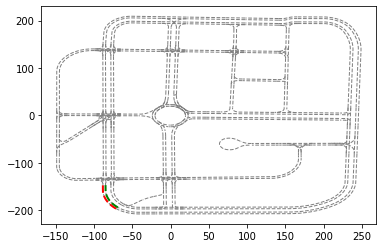

930350
ln id:  930349
None


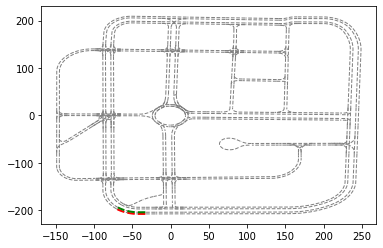

930122
ln id:  930121
None


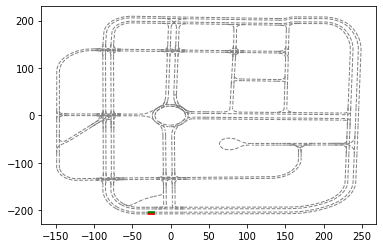

930373
ln id:  930372
None


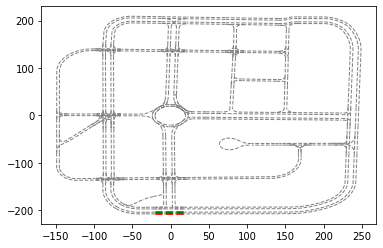

930127
ln id:  930126
None


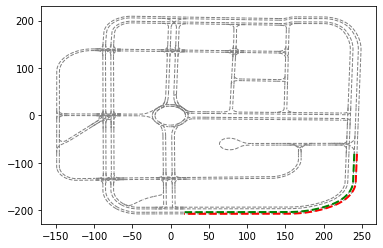

930069
ln id:  930068
None


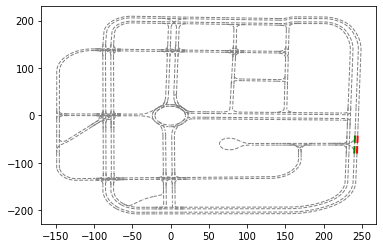

930132
ln id:  930131
None


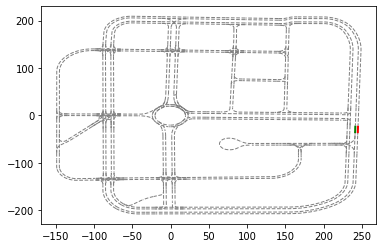

930051
ln id:  930050
None


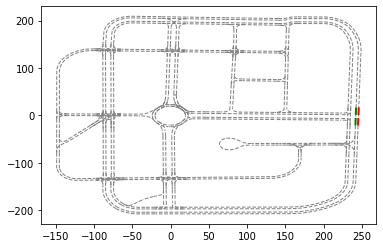

930136
ln id:  930135
None


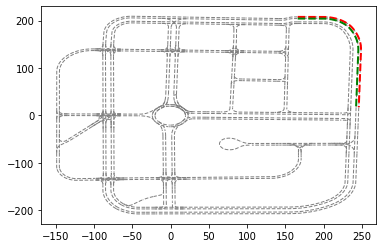

930375
None
None


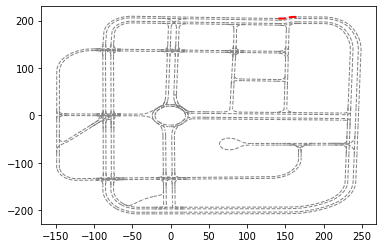

930216
ln id:  930217
None


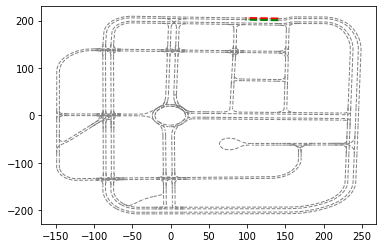

930385
ln id:  930386
None


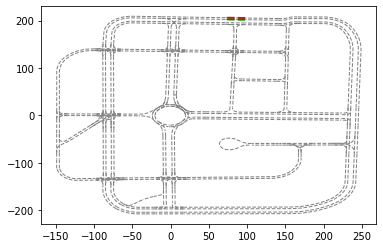

930220
ln id:  930221
None


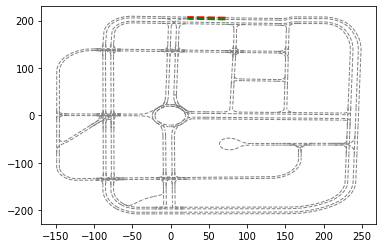

930111
ln id:  930112
None


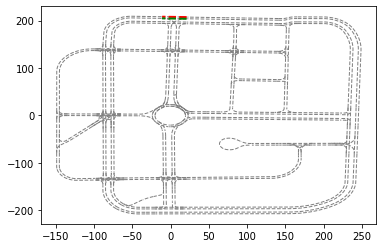

930212
ln id:  930213
None


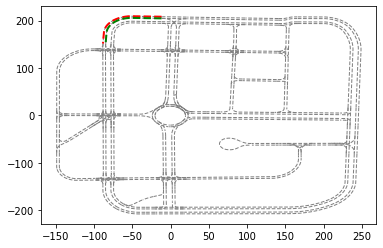

930400
None
None


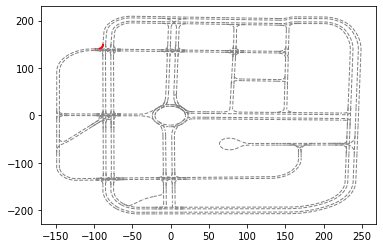

930324
None
None


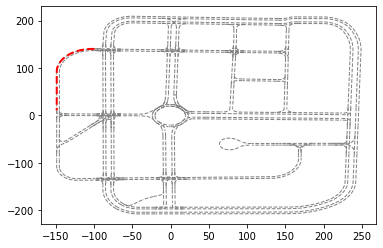

930063
None
None


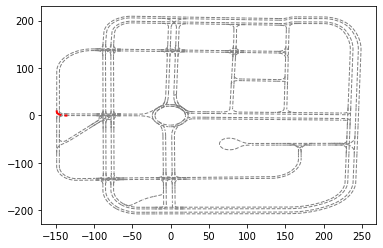

930009
None
None


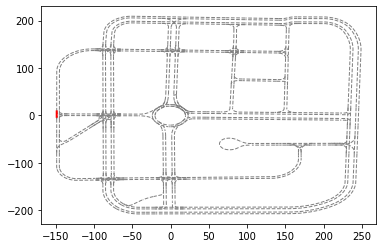

930176
None
None


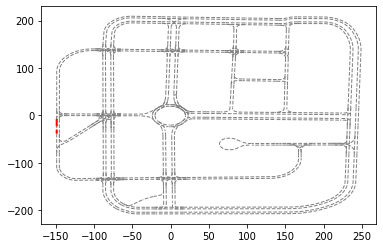

930005
None
None


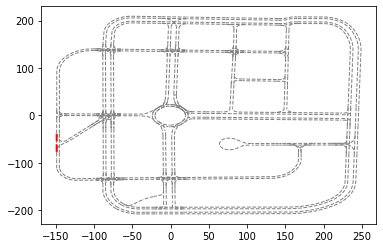

930174
None
None


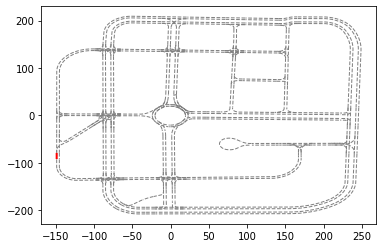

930326
None
None


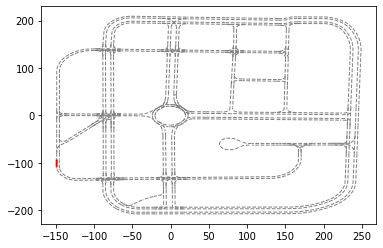

930245
None
None


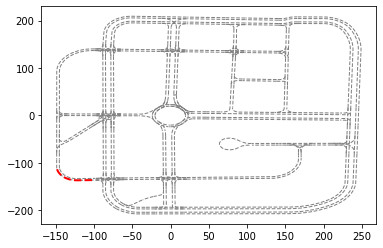

930353
None
None


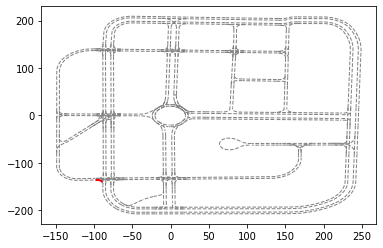

930392
None
None


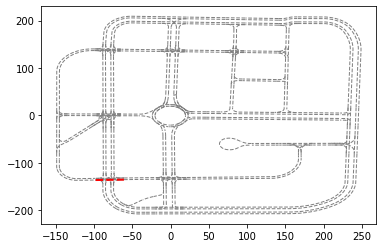

930316
None
None


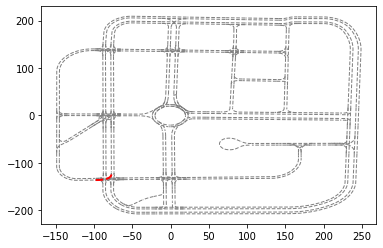

930260
None
rn id:  930261


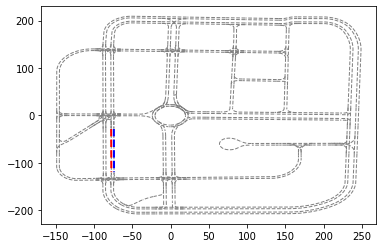

930076
None
None


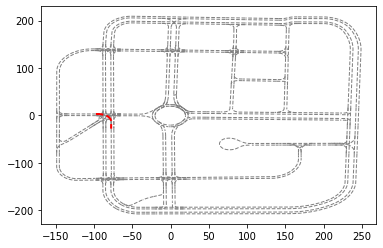

930138
None
None


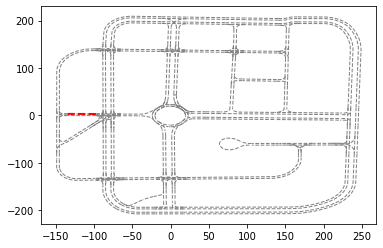

930007
None
None


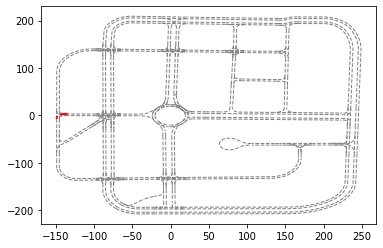

930008
None
None


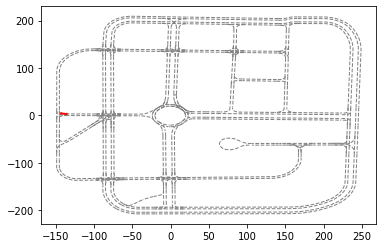

930325
None
None


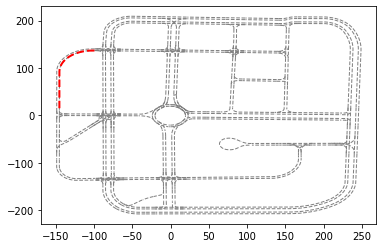

930291
None
None


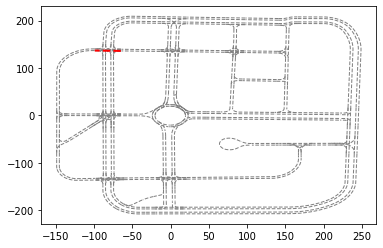

930182
None
None


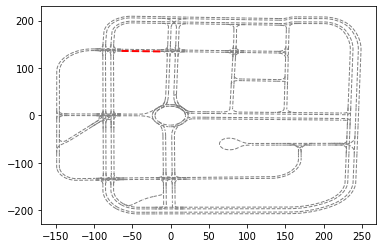

930363
None
None


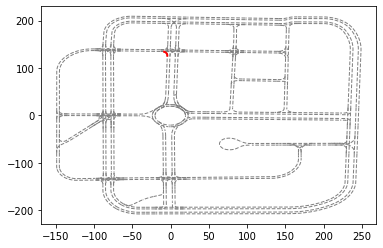

930270
ln id:  930269
None


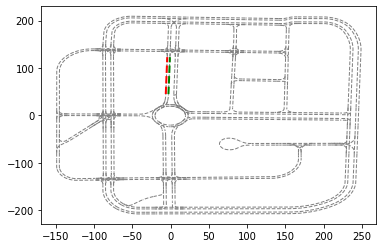

930155
ln id:  930154
None


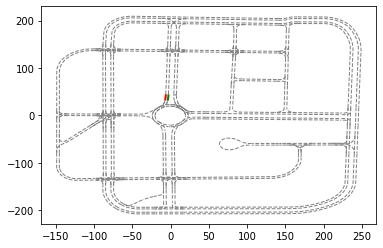

930306
ln id:  930307
None


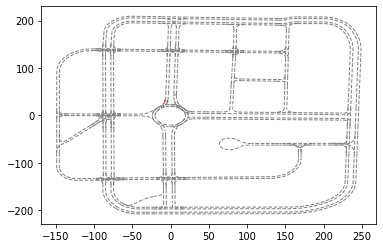

930019
ln id:  930020
None


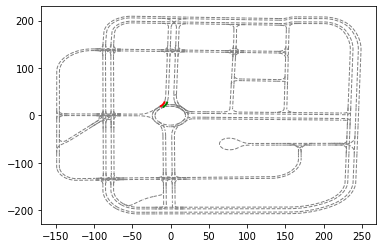

930141
None
None


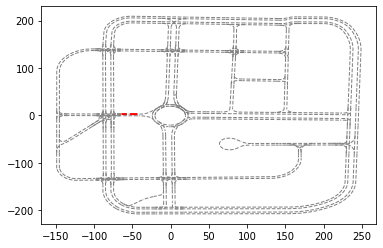

930070
None
None


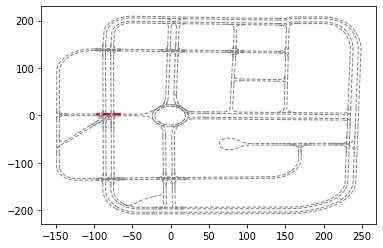

930071
None
None


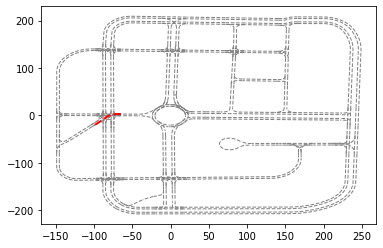

930331
None
rn id:  930330


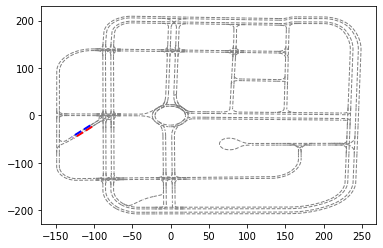

930387
None
None


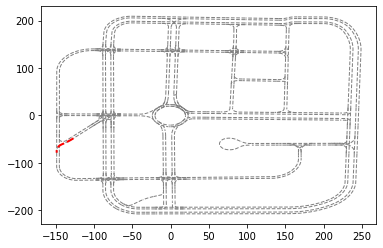

930073
None
None


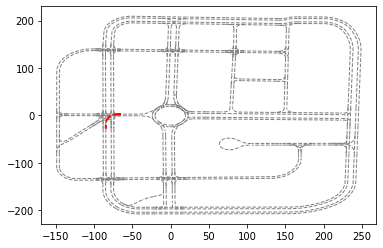

930259
None
rn id:  930258


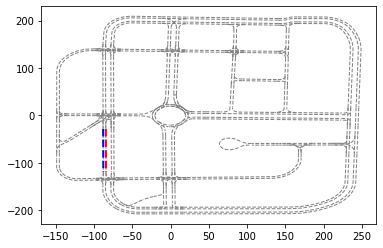

930346
None
None


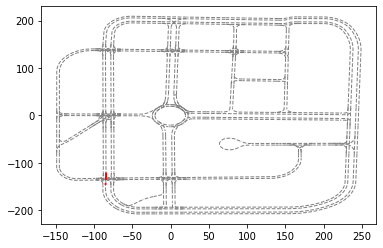

930117
None
rn id:  930118


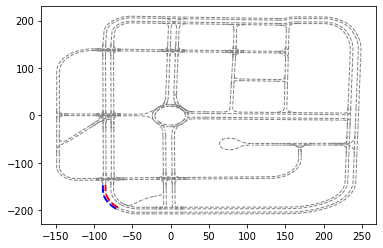

930349
None
rn id:  930350


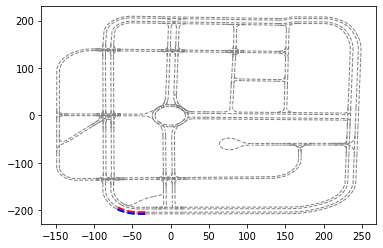

930121
None
rn id:  930122


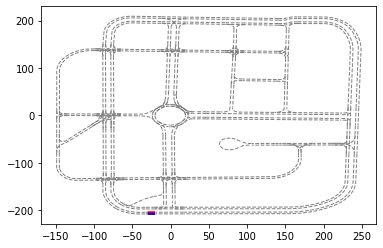

930372
None
rn id:  930373


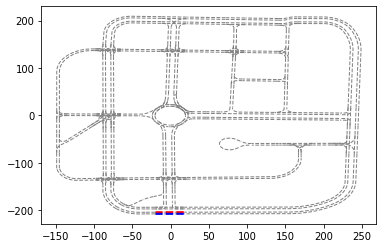

930126
None
rn id:  930127


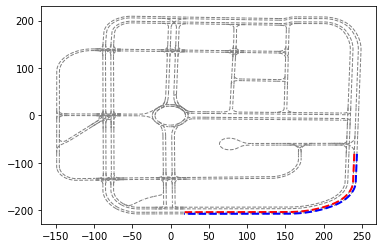

930068
None
rn id:  930069


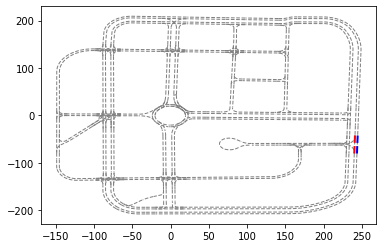

930131
None
rn id:  930132


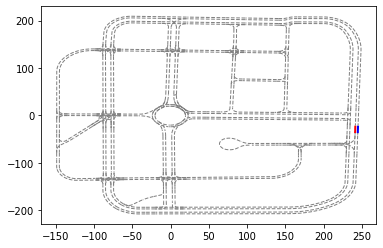

930050
None
rn id:  930051


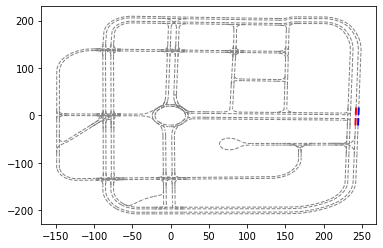

930135
None
rn id:  930136


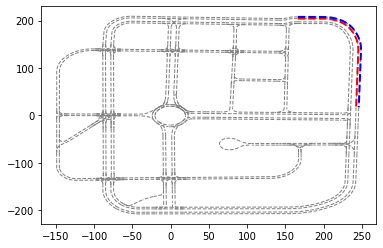

930248
None
None


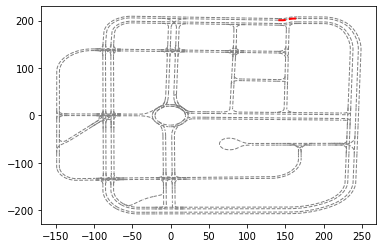

930217
None
rn id:  930216


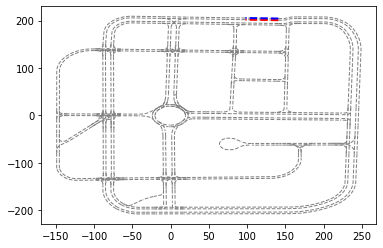

930386
None
rn id:  930385


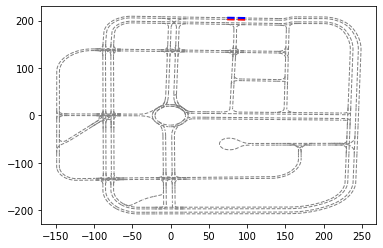

930221
None
rn id:  930220


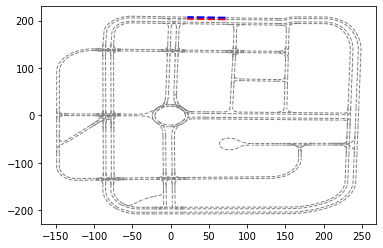

930388
None
None


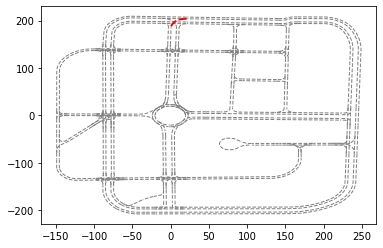

930274
None
rn id:  930275


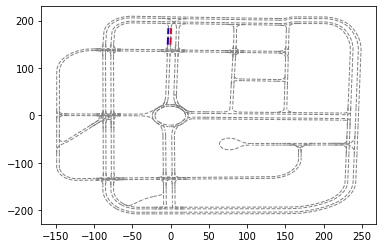

930036
None
rn id:  930037


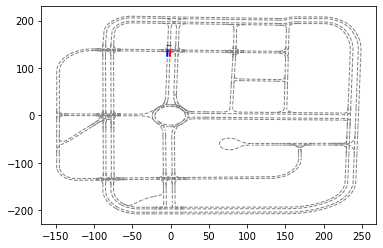

930269
None
rn id:  930270


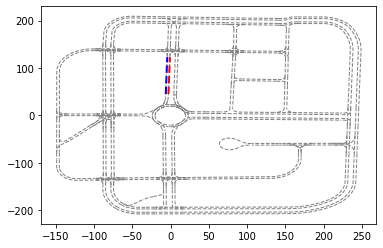

930154
None
rn id:  930155


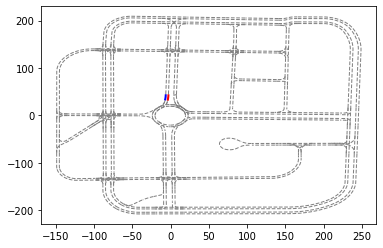

930307
None
rn id:  930306


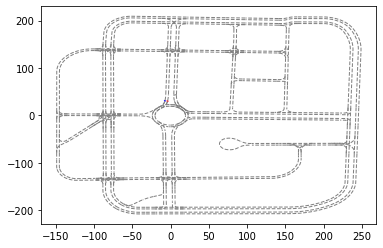

930020
ln id:  930021
rn id:  930019


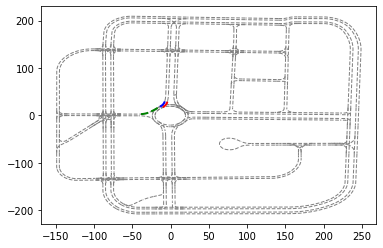

930356
None
rn id:  930355


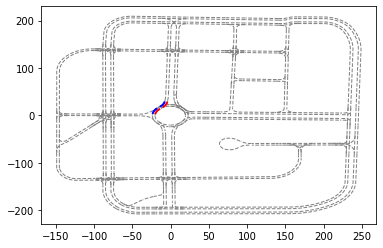

930313
None
rn id:  930312


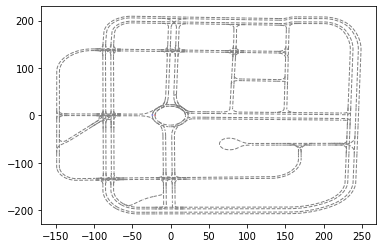

930187
None
None


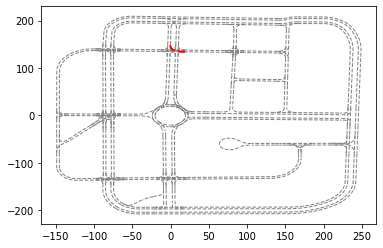

930184
None
None


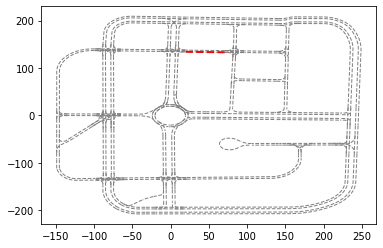

930315
None
None


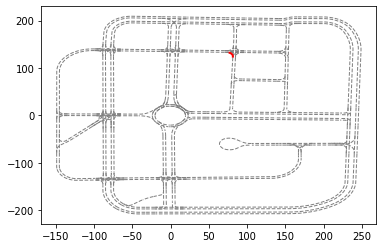

930322
None
None


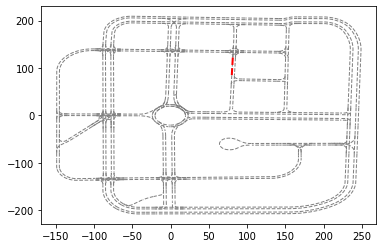

930013
None
None


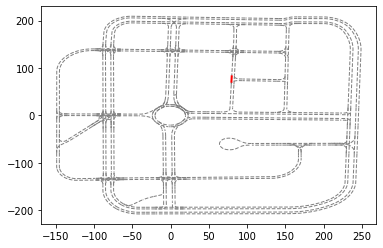

930327
None
None


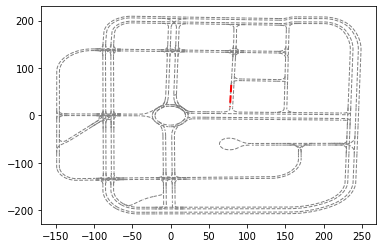

930090
None
None


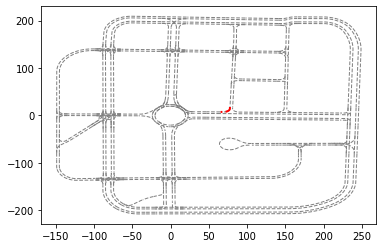

930234
ln id:  930235
None


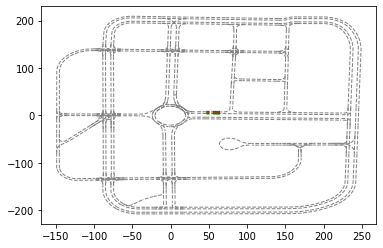

930042
ln id:  930043
None


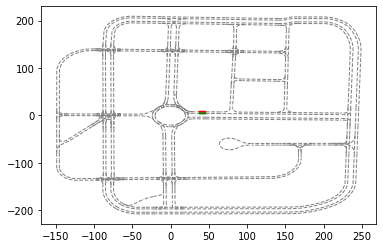

930257
None
None


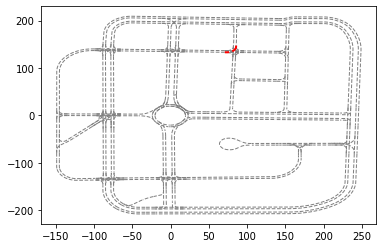

930318
None
None


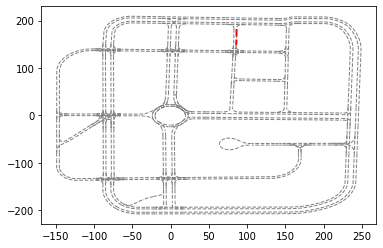

930255
None
None


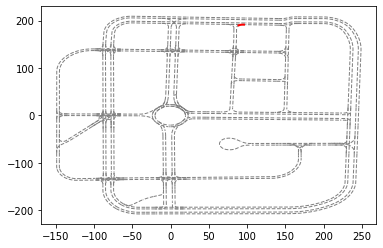

930219
ln id:  930218
None


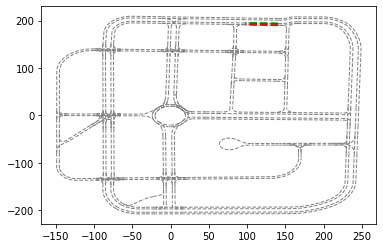

930376
None
None


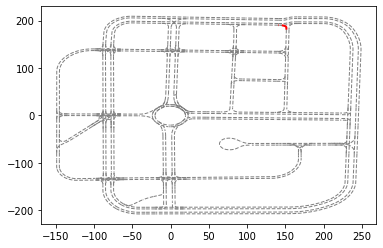

930105
None
None


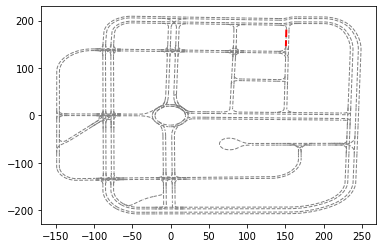

930017
None
None


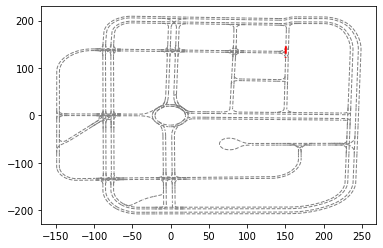

930364
None
None


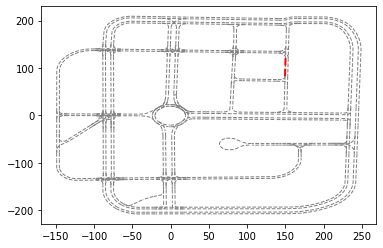

930027
None
None


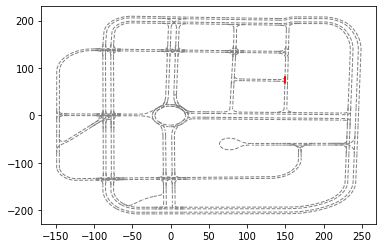

930102
None
None


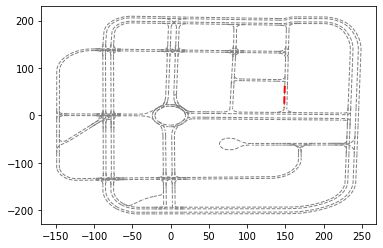

930044
None
None


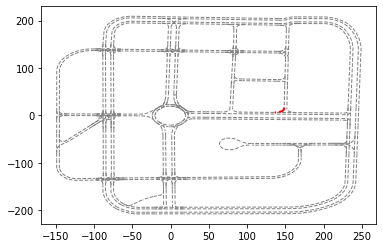

930230
ln id:  930231
None


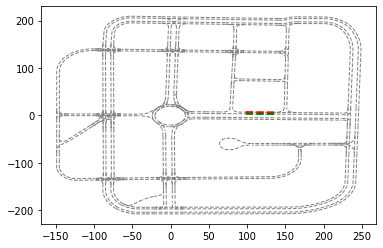

930369
None
None


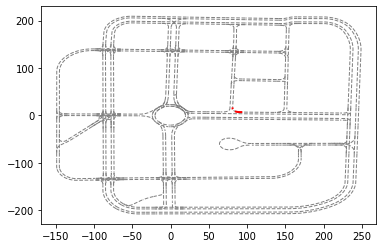

930328
None
None


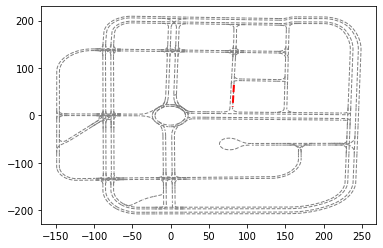

930014
None
None


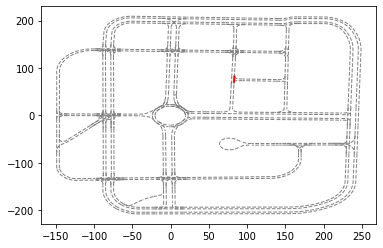

930323
None
None


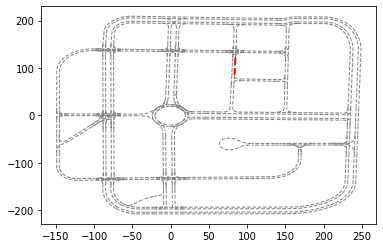

930336
None
None


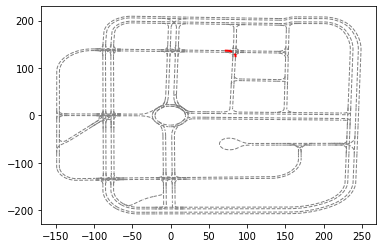

930183
None
None


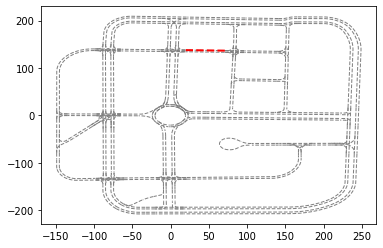

930314
None
None


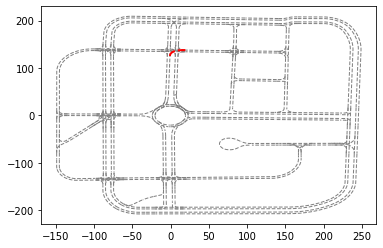

930249
None
None


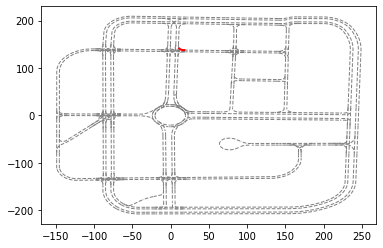

930272
ln id:  930273
None


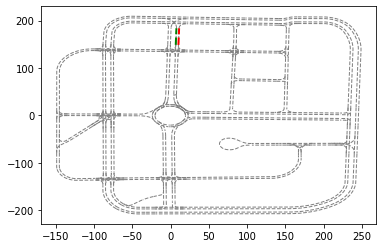

930205
None
None


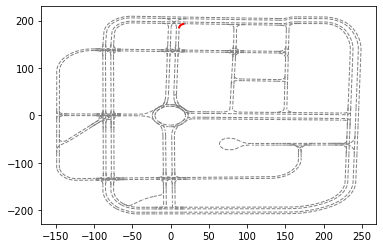

930223
ln id:  930222
None


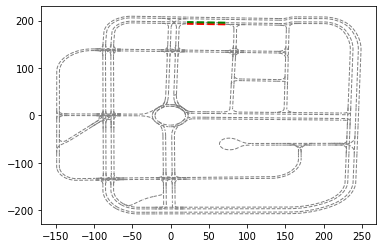

930295
None
None


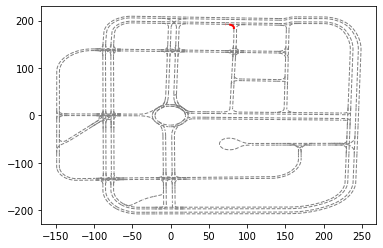

930317
None
None


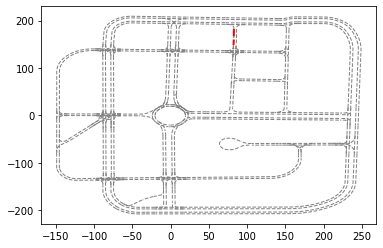

930311
None
None


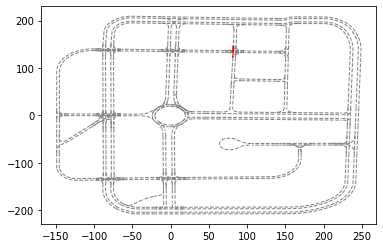

930238
None
None


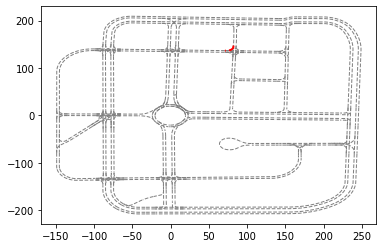

930358
None
None


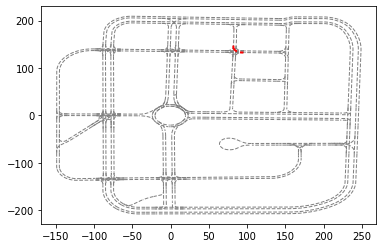

930186
None
None


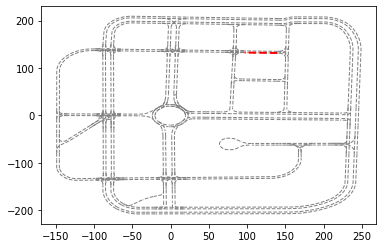

930097
None
None


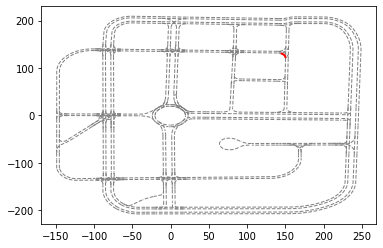

930123
None
None


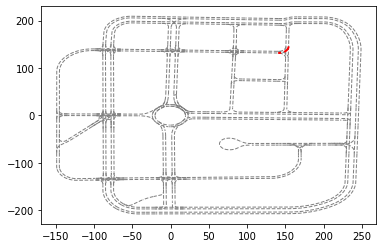

930106
None
None


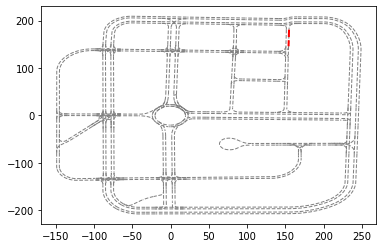

930382
None
None


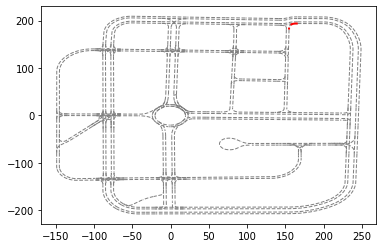

930133
ln id:  930134
None


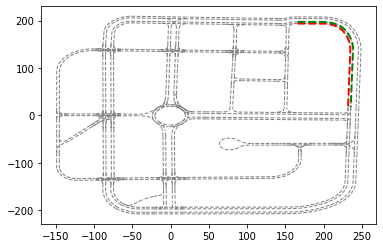

930052
ln id:  930053
None


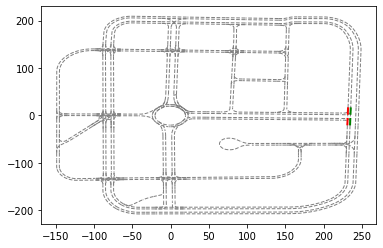

930129
ln id:  930130
None


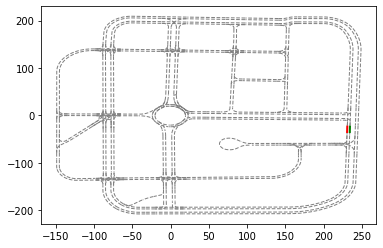

930031
ln id:  930032
None


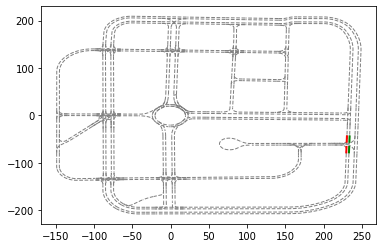

930124
ln id:  930125
None


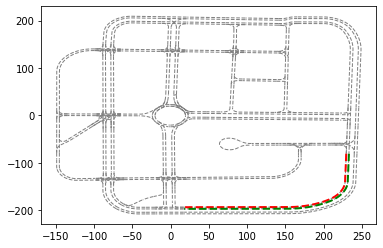

930203
ln id:  930204
None


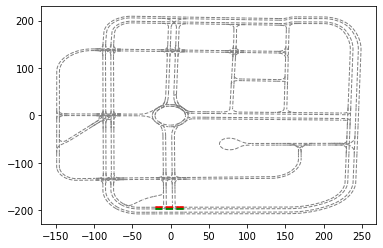

930119
ln id:  930120
None


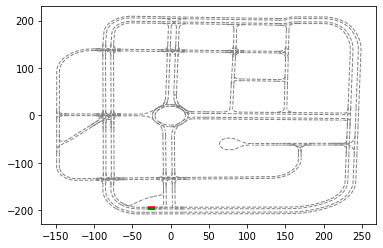

930199
None
None


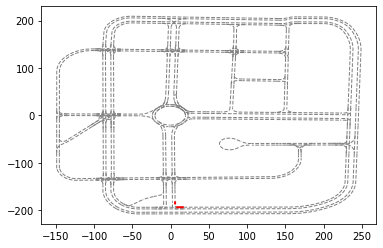

930335
ln id:  930334
None


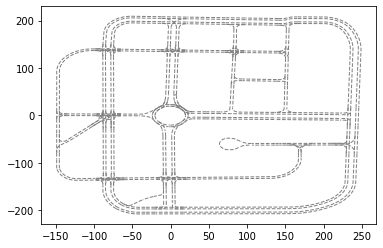

930289
ln id:  930288
None


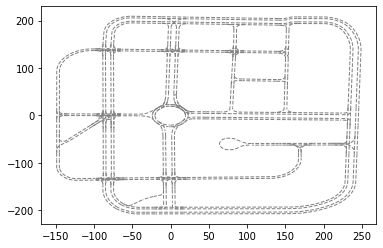

930065
ln id:  930064
None


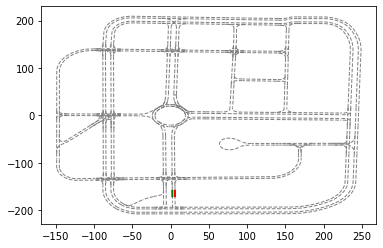

930285
ln id:  930284
None


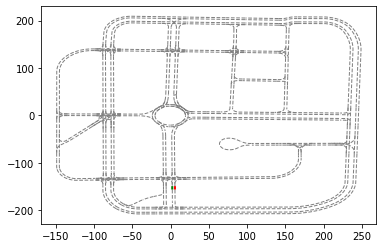

930294
None
None


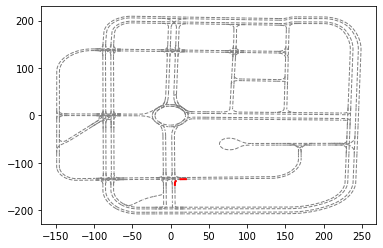

930342
ln id:  930341
None


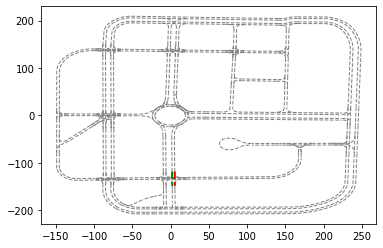

930280
ln id:  930279
None


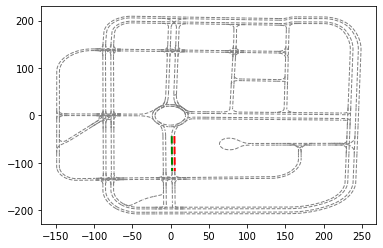

930380
ln id:  930379
None


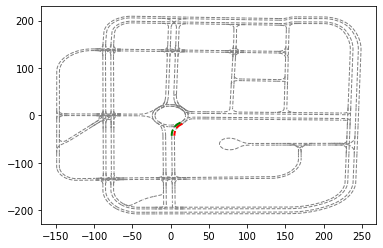

930241
ln id:  930242
None


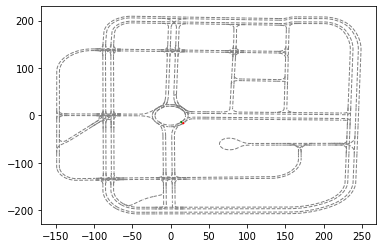

930038
ln id:  930039
None


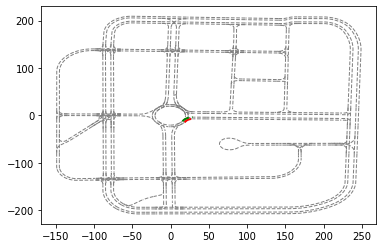

930040
ln id:  930041
None


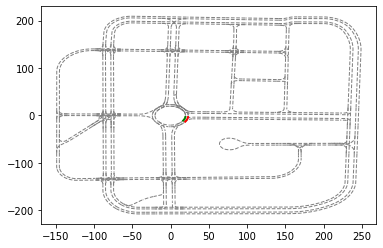

930197
ln id:  930198
None


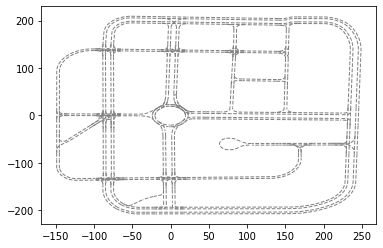

930297
ln id:  930298
None


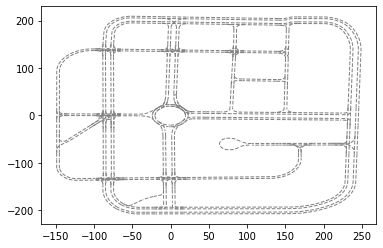

930389
ln id:  930390
None


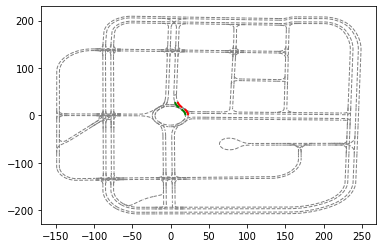

930191
ln id:  930190
None


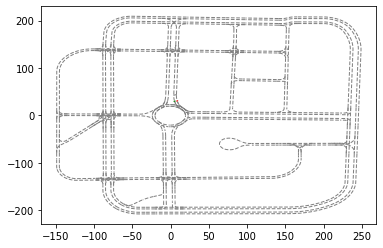

930167
ln id:  930166
None


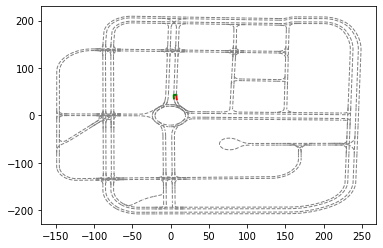

930086
ln id:  930087
None


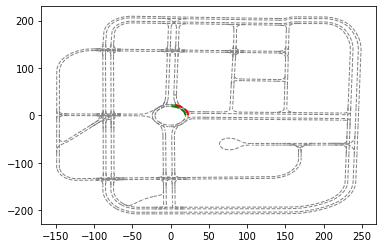

930302
ln id:  930303
None


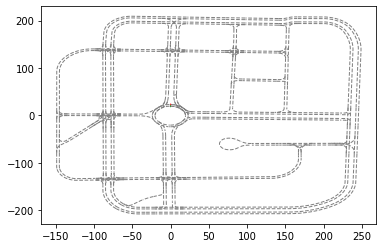

930309
ln id:  930310
None


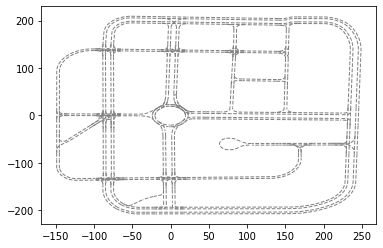

930243
ln id:  930244
None


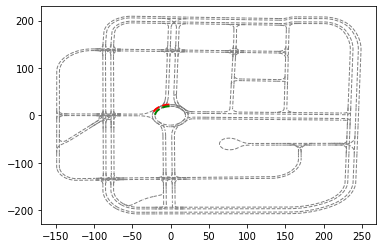

930312
ln id:  930313
None


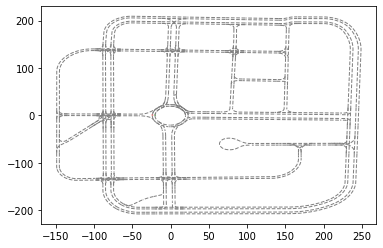

930034
None
None


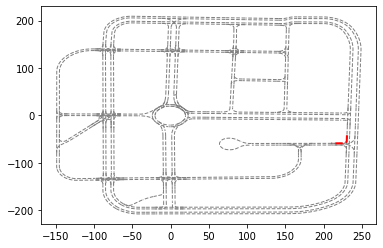

930171
None
None


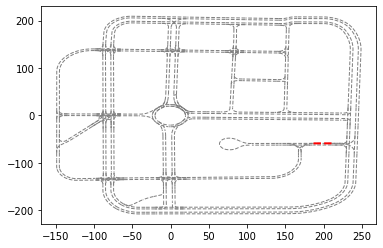

930058
None
None


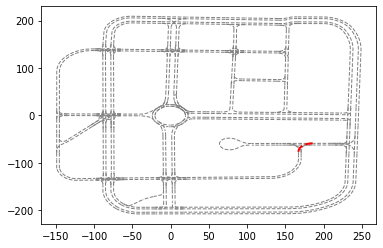

930062
None
None


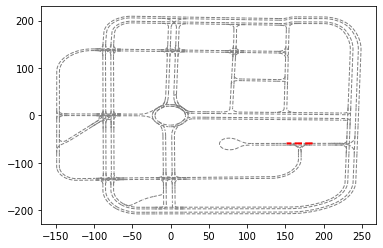

930054
None
None


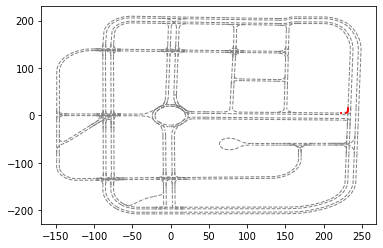

930262
ln id:  930263
None


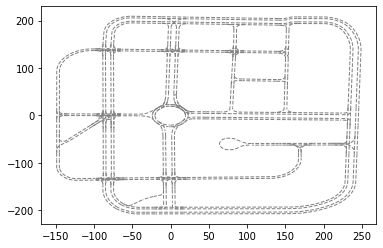

930225
ln id:  930226
None


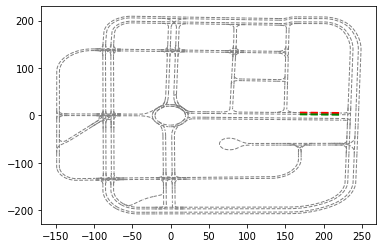

930045
None
None


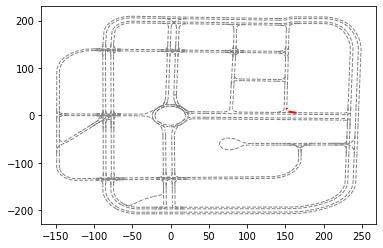

930103
None
None


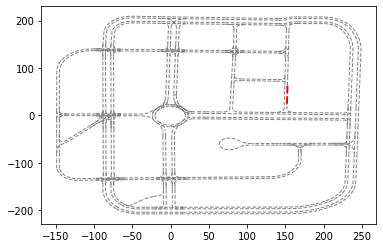

930059
None
None


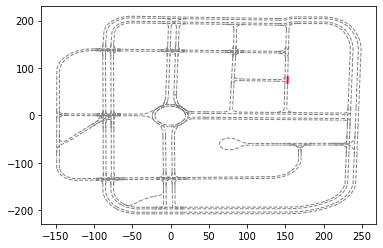

930365
None
None


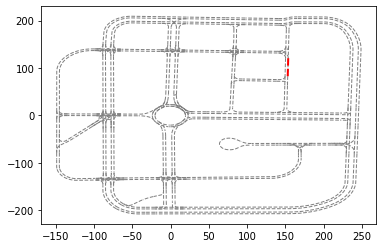

930018
None
None


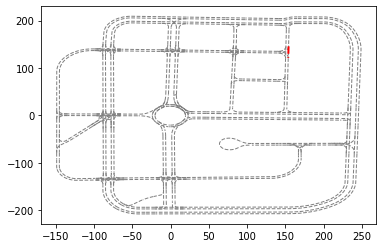

930107
None
None


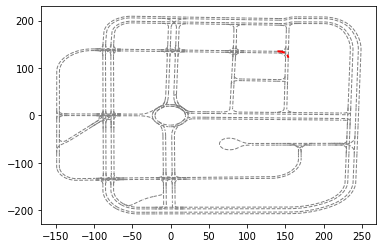

930185
None
None


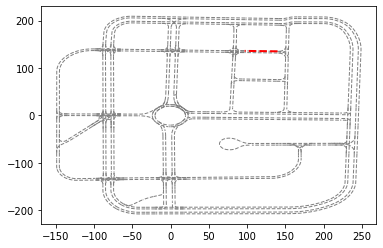

930362
None
None


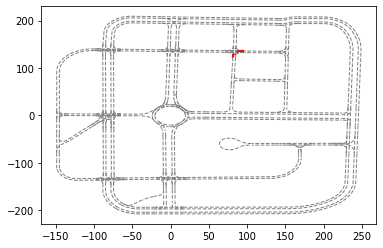

930360
None
None


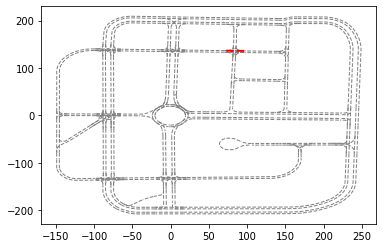

930359
None
None


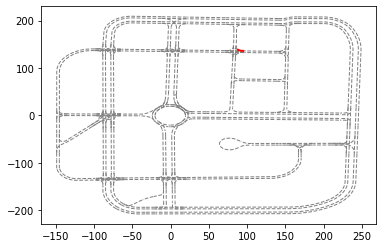

930281
None
None


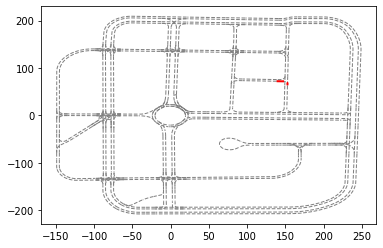

930145
None
rn id:  930144


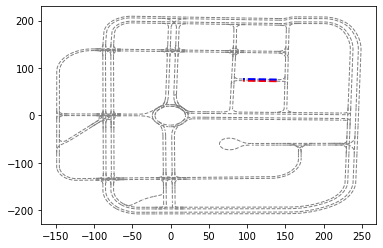

930011
None
None


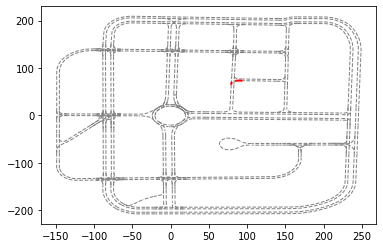

930046
ln id:  930047
None


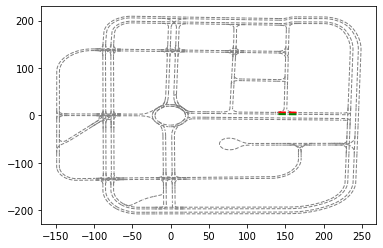

930384
ln id:  930383
None


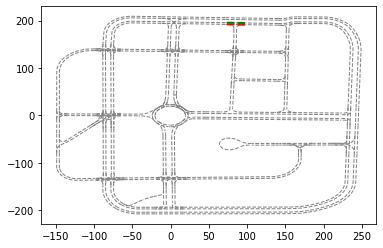

930206
None
None


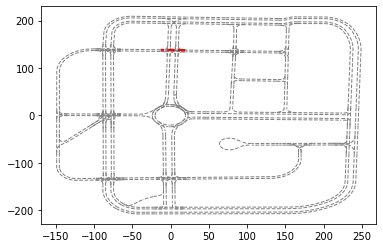

930181
None
None


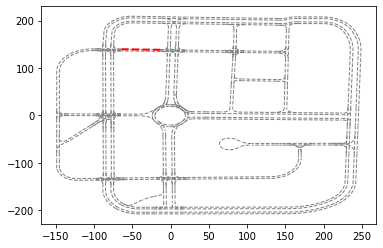

930296
None
None


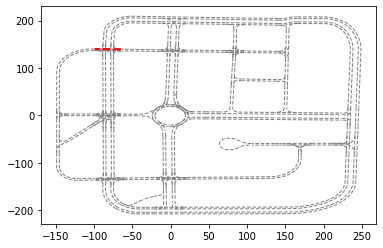

930194
None
None


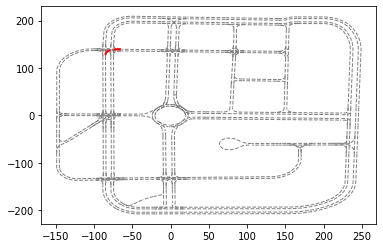

930208
None
rn id:  930207


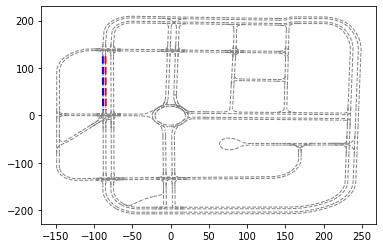

930078
None
None


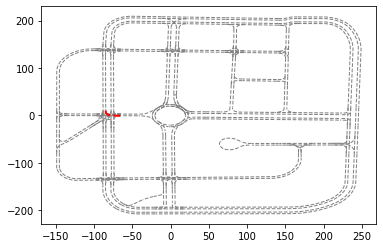

930149
None
rn id:  930148


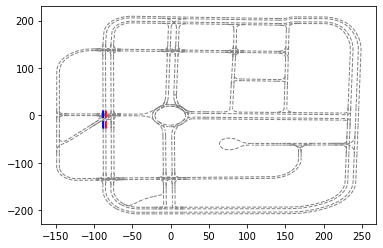

930399
None
None


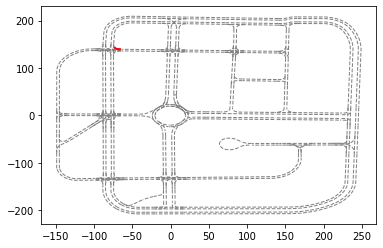

930215
ln id:  930214
None


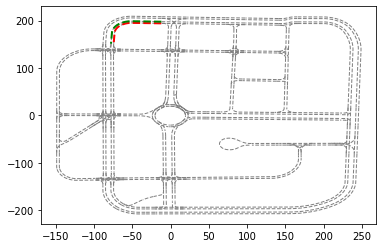

930393
None
None


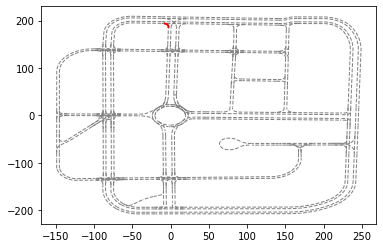

930275
ln id:  930274
None


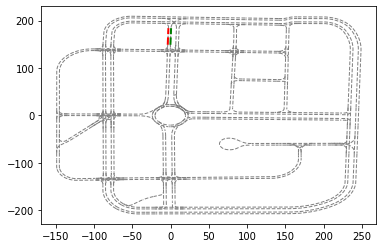

930037
ln id:  930036
None


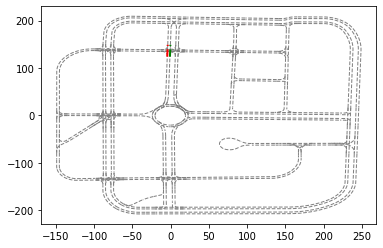

930168
None
None


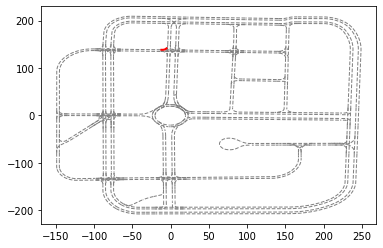

930114
ln id:  930113
None


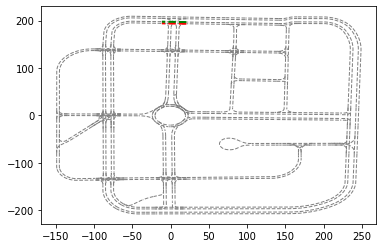

930308
None
None


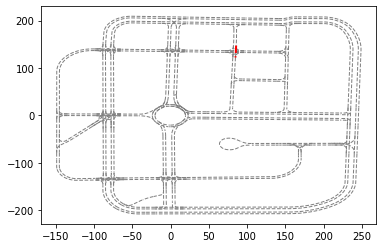

930224
None
None


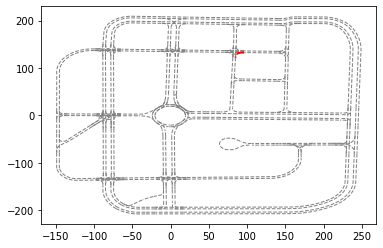

930028
None
None


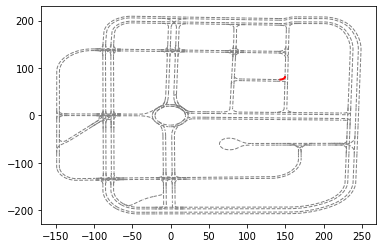

930144
ln id:  930145
None


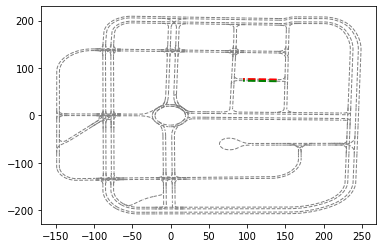

930012
None
None


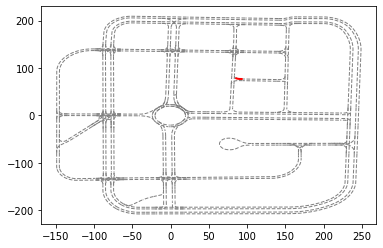

930140
None
None


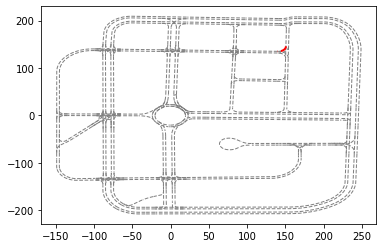

930200
None
None


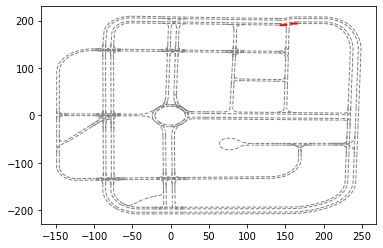

930345
None
None


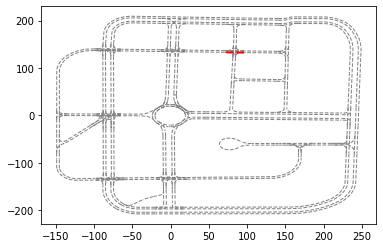

930112
None
rn id:  930111


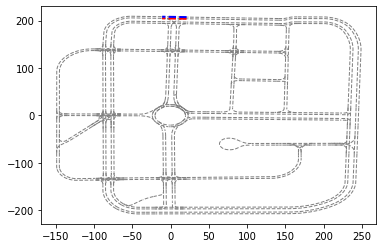

930213
None
rn id:  930212


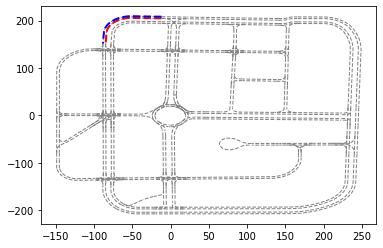

930396
None
None


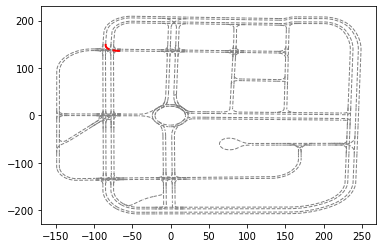

930378
None
rn id:  930377


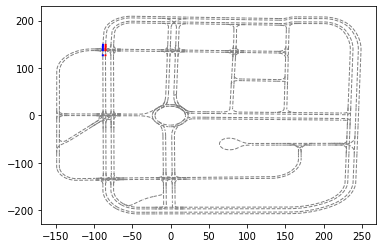

930035
None
None


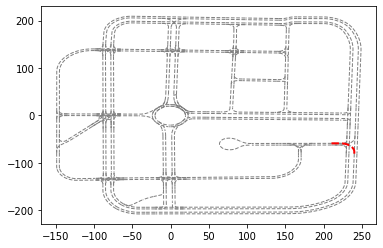

930137
None
None


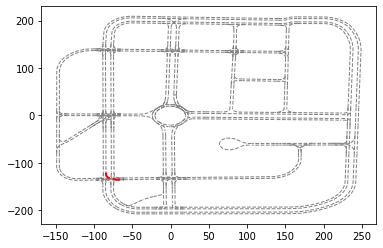

930081
None
None


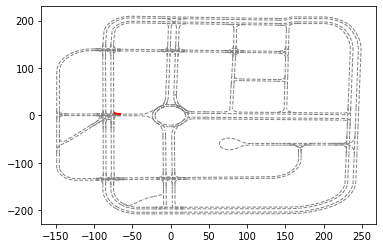

930210
ln id:  930209
None


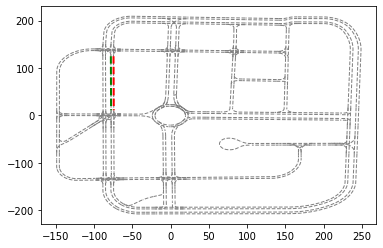

930178
None
None


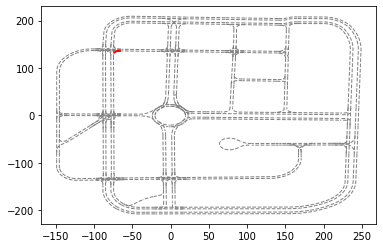

930395
ln id:  930394
None


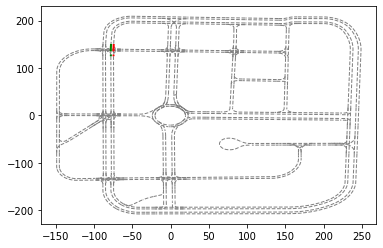

930355
ln id:  930356
None


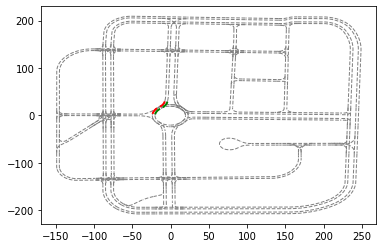

930147
None
None


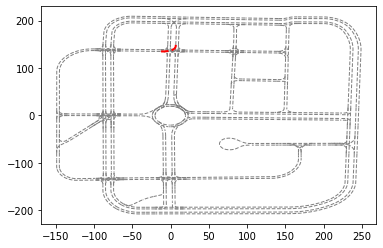

930273
None
rn id:  930272


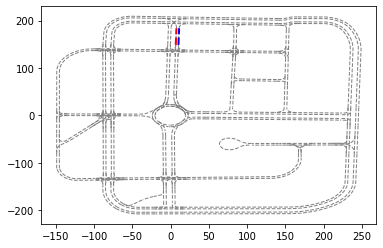

930391
None
None


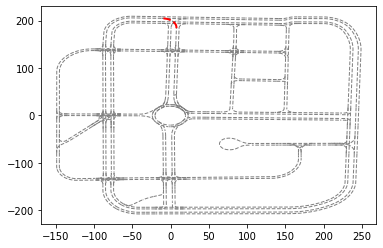

930211
None
None


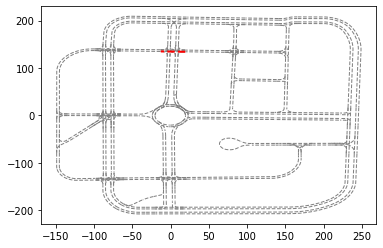

930266
None
None


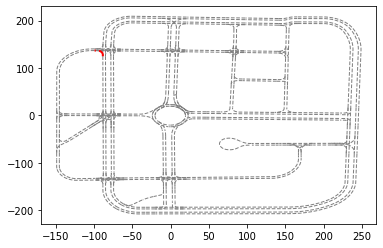

930207
ln id:  930208
None


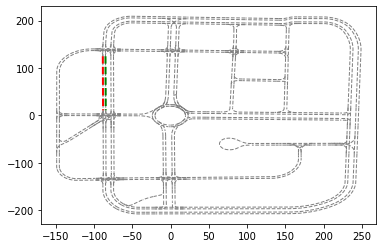

930202
None
None


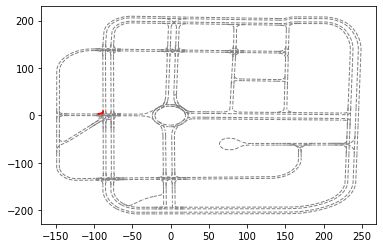

930084
None
None


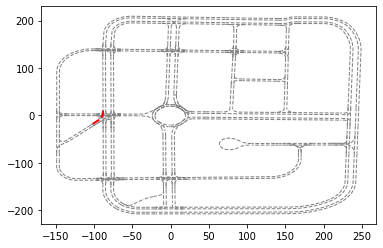

930148
ln id:  930149
None


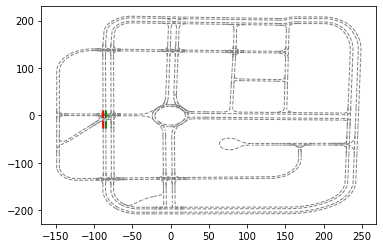

930361
None
None


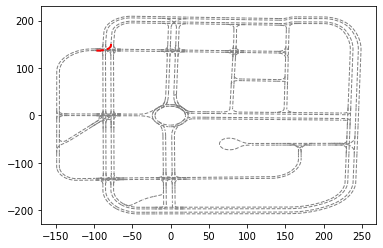

930214
None
rn id:  930215


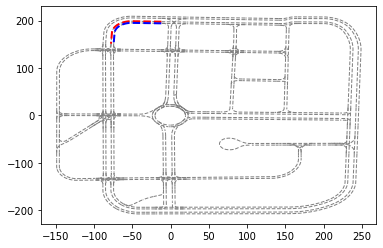

930113
None
rn id:  930114


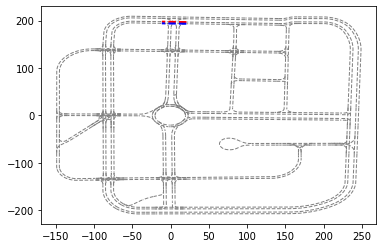

930222
None
rn id:  930223


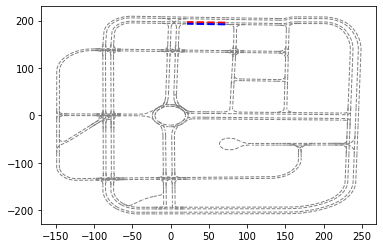

930383
None
rn id:  930384


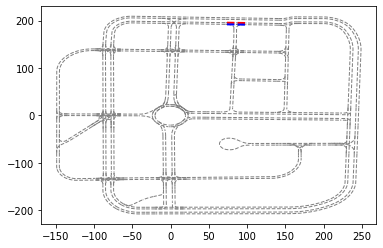

930218
None
rn id:  930219


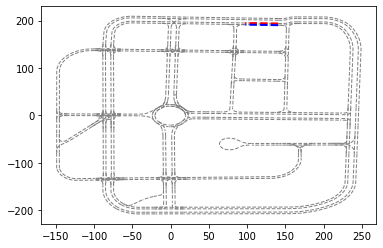

930374
None
None


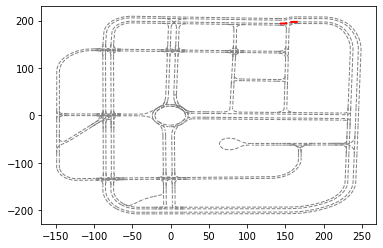

930134
None
rn id:  930133


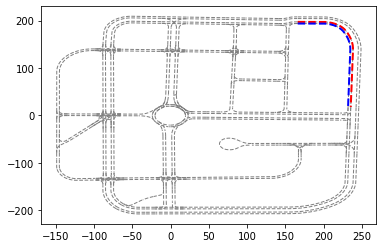

930053
None
rn id:  930052


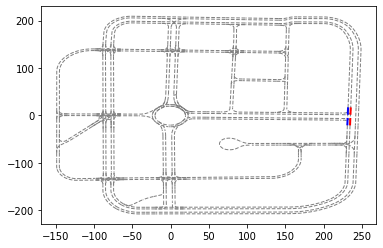

930130
None
rn id:  930129


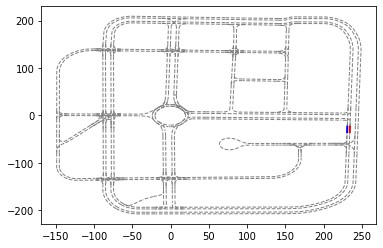

930032
None
rn id:  930031


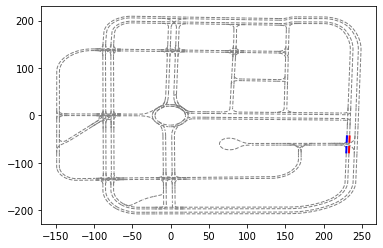

930125
None
rn id:  930124


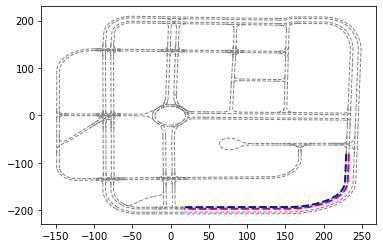

930204
None
rn id:  930203


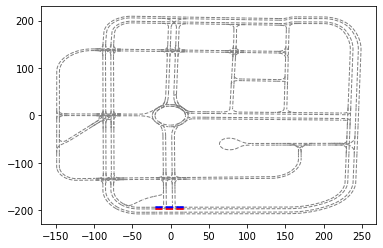

930083
None
None


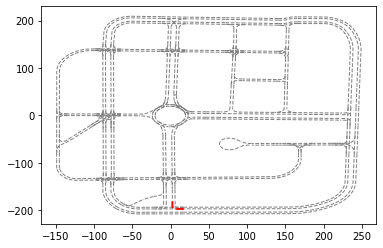

930334
None
rn id:  930335


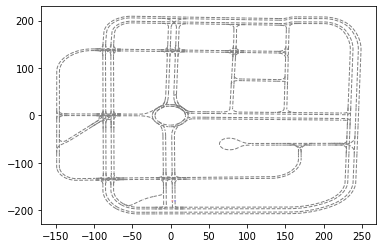

930288
None
rn id:  930289


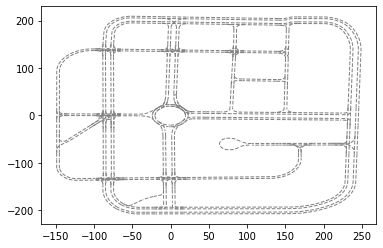

930064
None
rn id:  930065


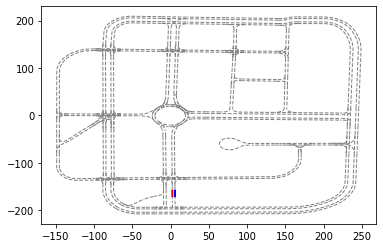

930284
None
rn id:  930285


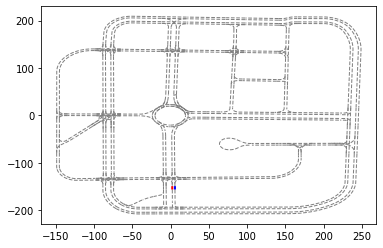

930341
None
rn id:  930342


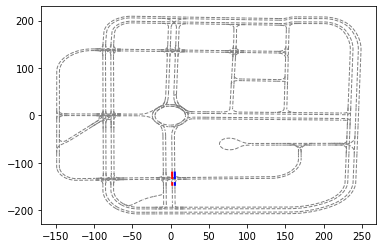

930279
None
rn id:  930280


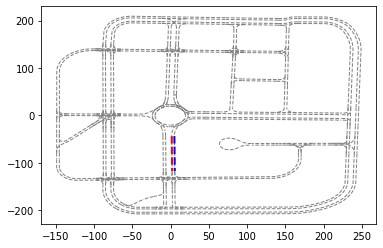

930379
None
rn id:  930380


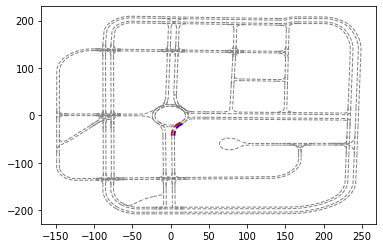

930242
None
rn id:  930241


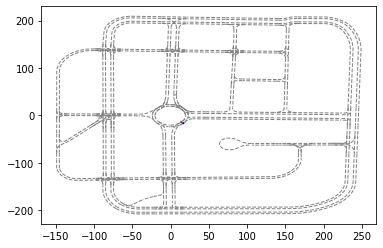

930039
None
rn id:  930038


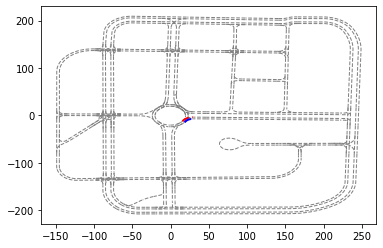

930041
None
rn id:  930040


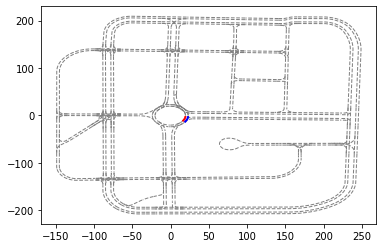

930198
None
rn id:  930197


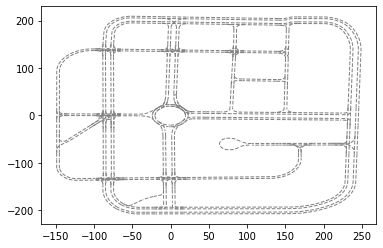

930298
None
rn id:  930297


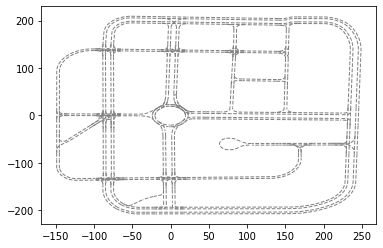

930390
None
rn id:  930389


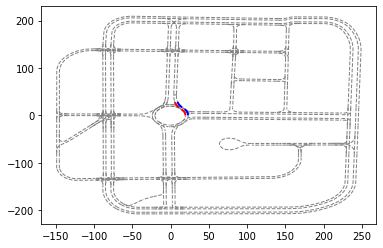

930190
None
rn id:  930191


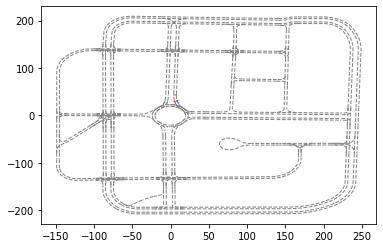

930166
ln id:  930165
rn id:  930167


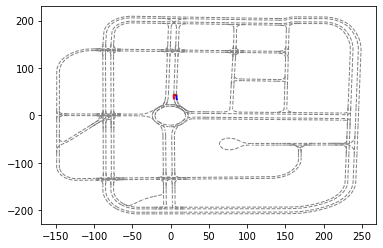

930267
ln id:  930268
None


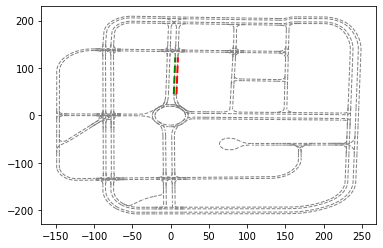

930079
ln id:  930080
None


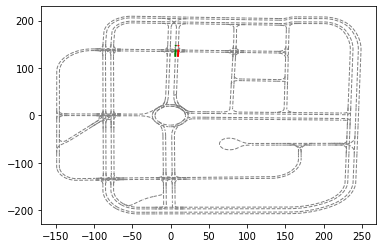

930276
None
None


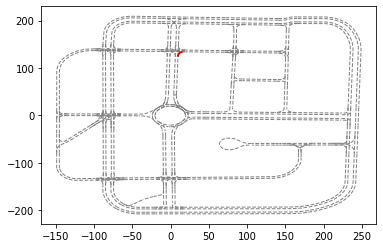

930087
None
rn id:  930086


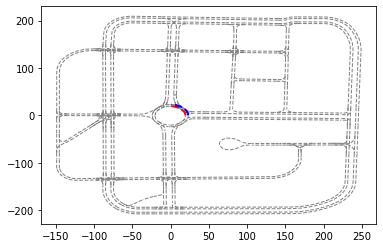

930303
None
rn id:  930302


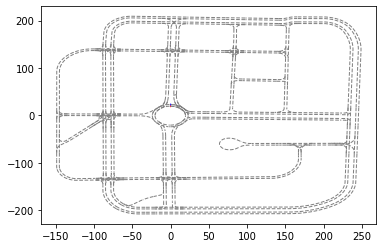

930310
None
rn id:  930309


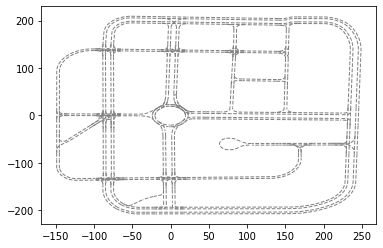

930244
None
rn id:  930243


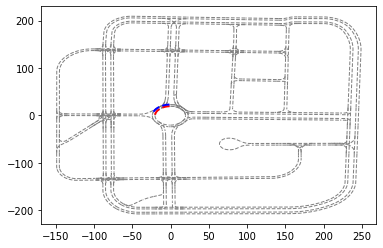

930256
None
None


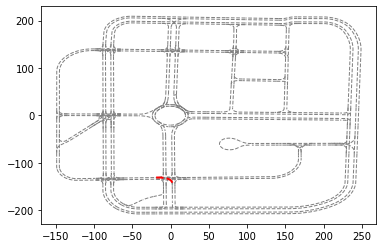

930251
None
None


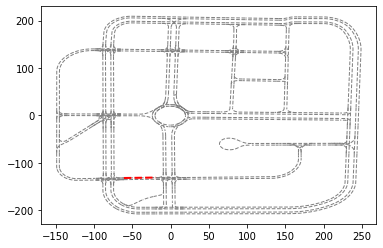

930357
None
None


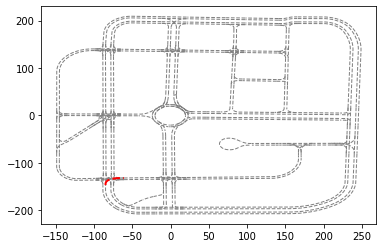

930348
None
None


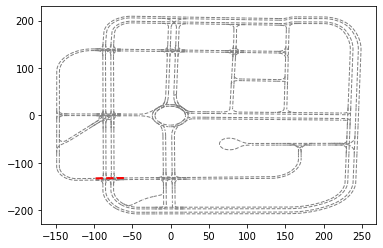

930153
None
None


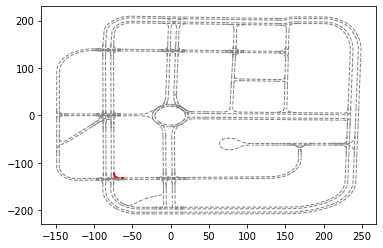

930261
ln id:  930260
None


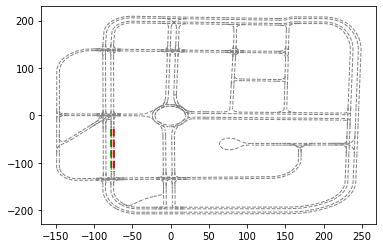

930074
None
None


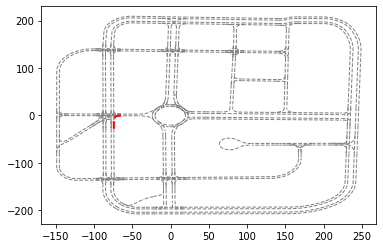

930151
ln id:  930150
None


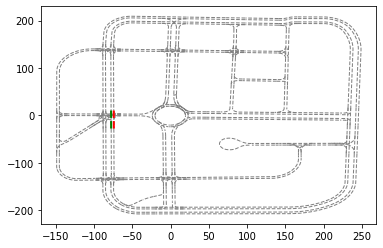

930320
None
None


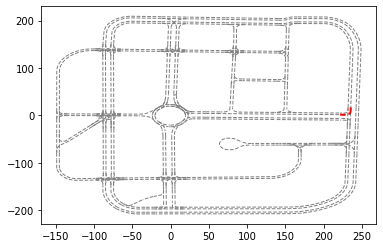

930263
None
rn id:  930262


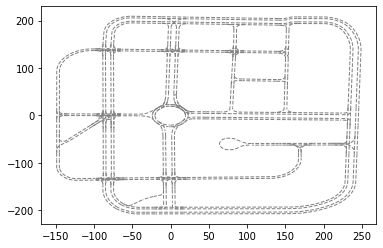

930226
None
rn id:  930225


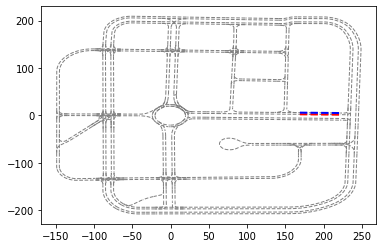

930047
None
rn id:  930046


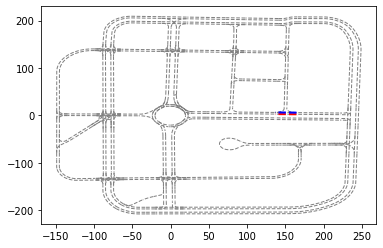

930231
None
rn id:  930230


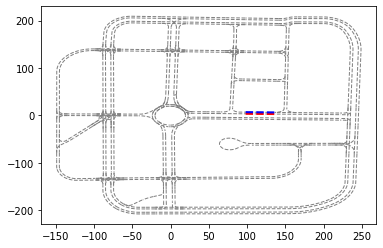

930104
None
None


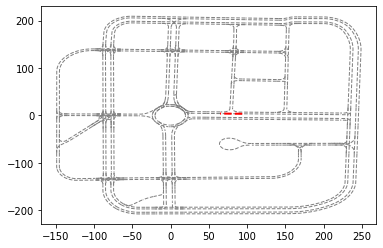

930235
None
rn id:  930234


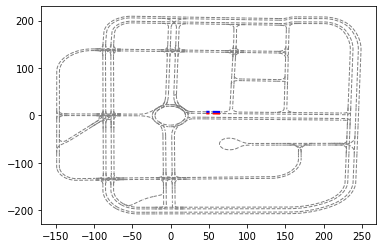

930043
None
rn id:  930042


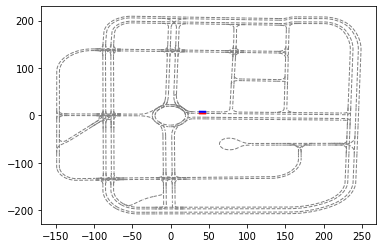

930077
None
None


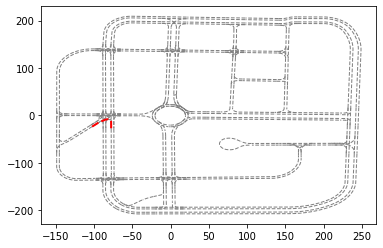

930150
None
rn id:  930151


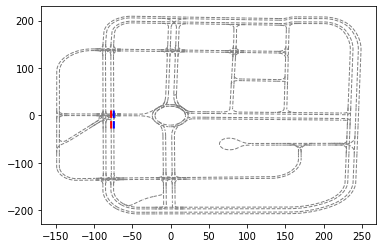

930209
None
rn id:  930210


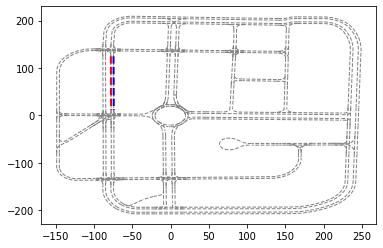

930301
None
None


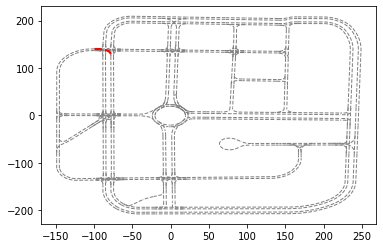

930394
None
rn id:  930395


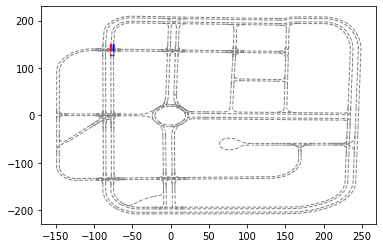

930377
ln id:  930378
None


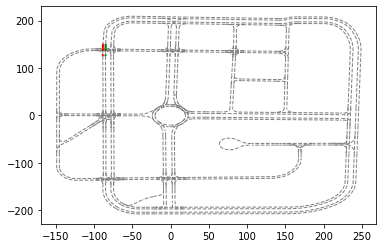

930173
None
None


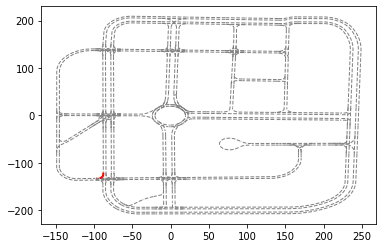

930082
None
None


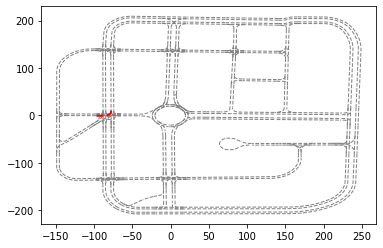

930010
None
None


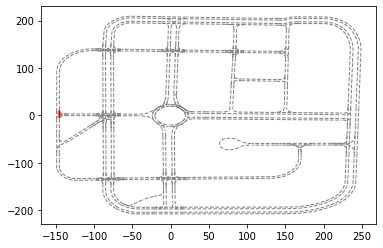

930088
None
None


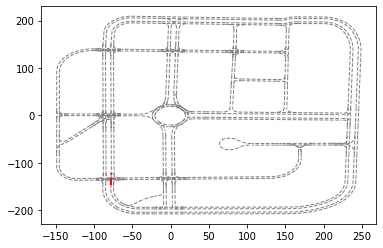

930201
None
None


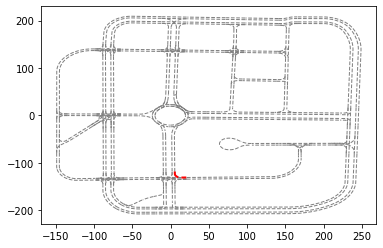

930340
None
None


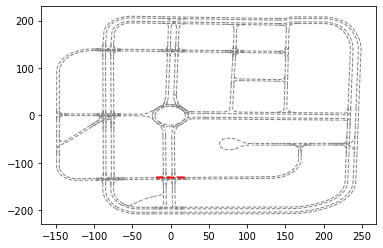

930329
None
None


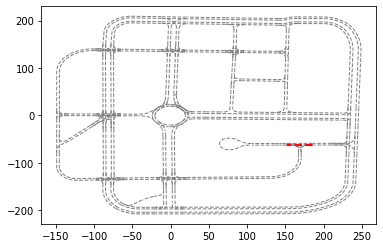

930172
None
None


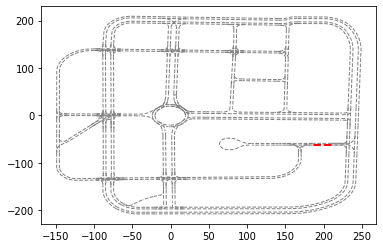

930033
None
None


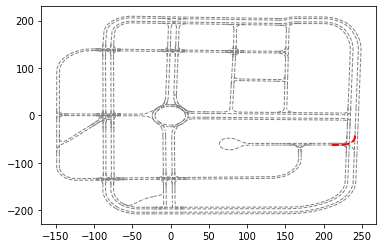

930381
None
None


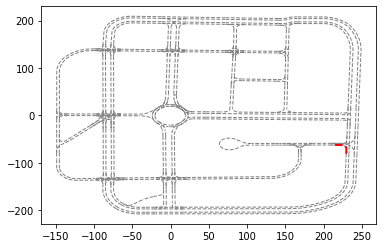

930060
None
None


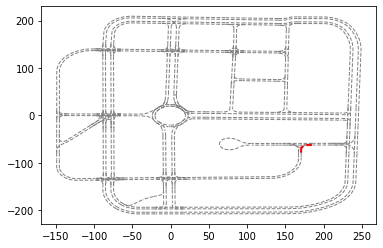

930290
None
None


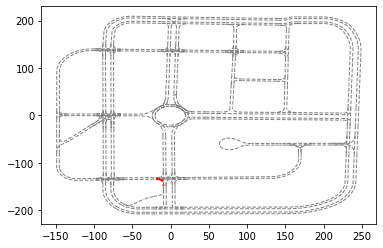

930282
ln id:  930283
None


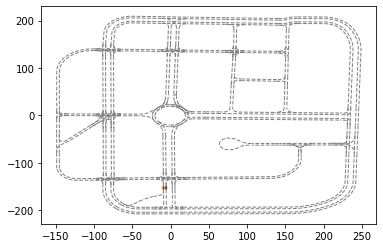

930252
ln id:  930253
None


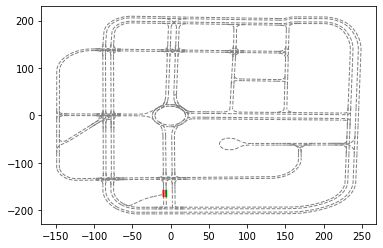

930286
ln id:  930287
None


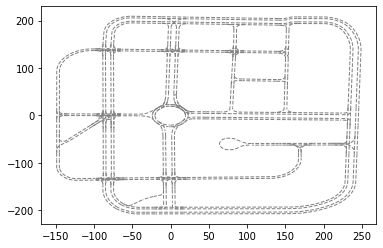

930332
ln id:  930333
None


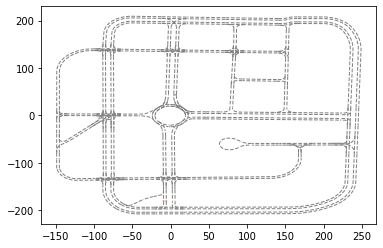

930368
None
None


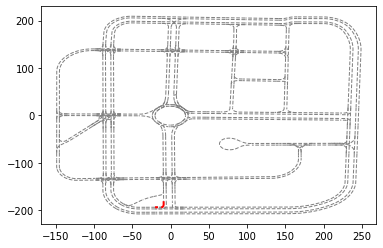

930066
None
None


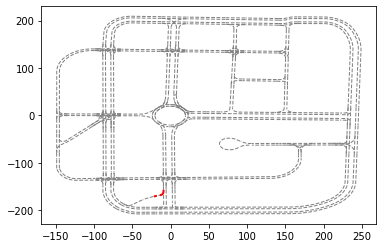

930146
None
None


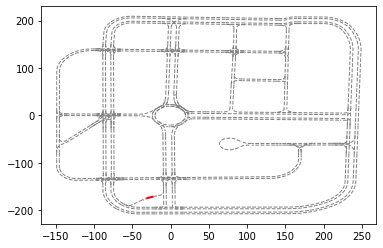

930003
None
None


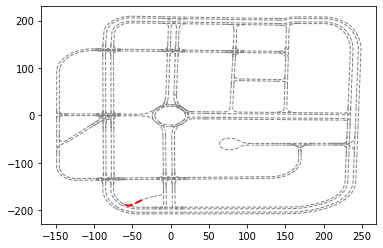

930247
None
None


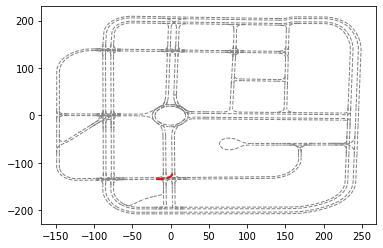

930110
None
None


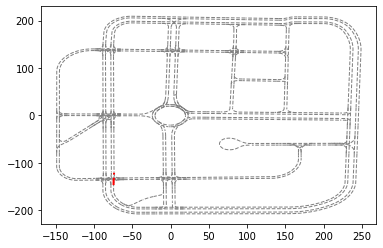

930015
ln id:  930016
None


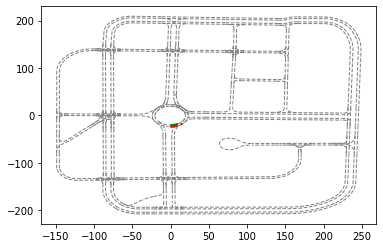

930016
None
rn id:  930015


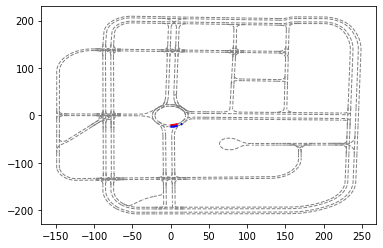

930021
None
rn id:  930020


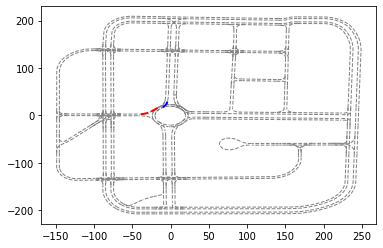

930022
None
None


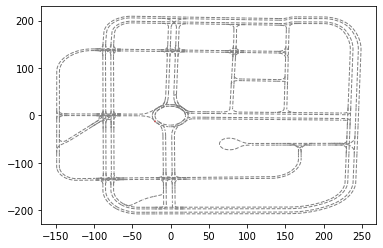

930299
ln id:  930300
None


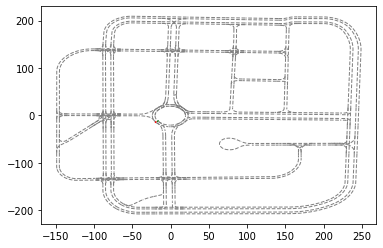

930304
ln id:  930305
None


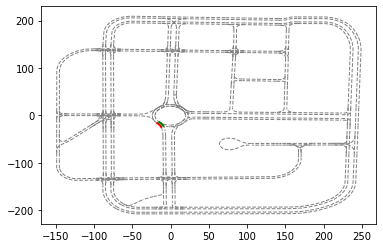

930179
ln id:  930180
None


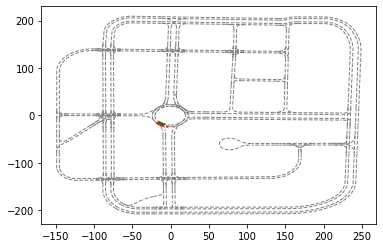

930192
ln id:  930193
None


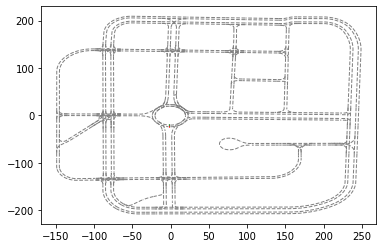

930239
ln id:  930240
None


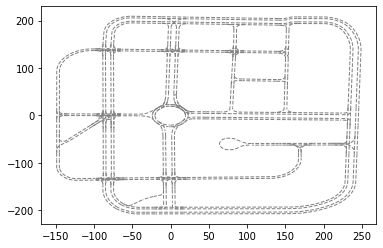

930023
ln id:  930024
None


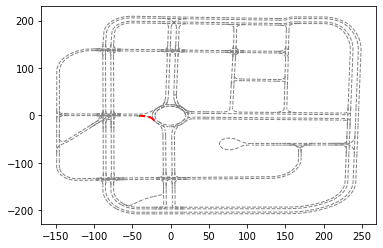

930025
ln id:  930026
None


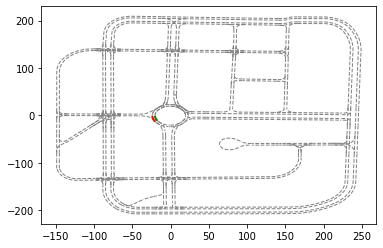

930026
None
rn id:  930025


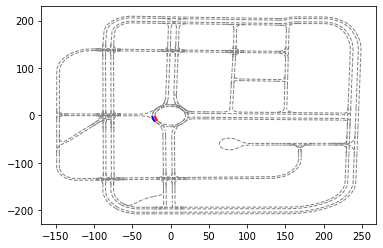

930300
None
rn id:  930299


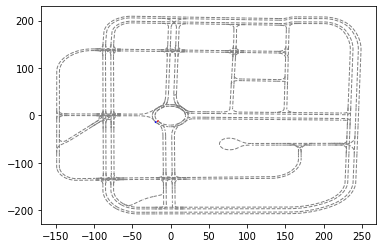

930305
None
rn id:  930304


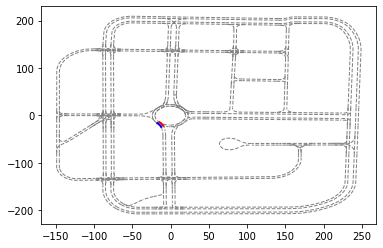

930180
None
rn id:  930179


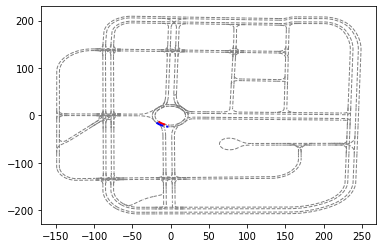

930193
None
rn id:  930192


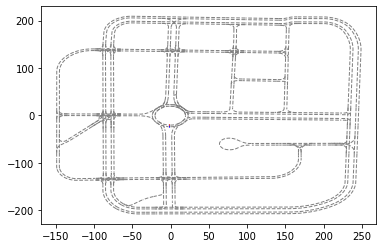

930240
None
rn id:  930239


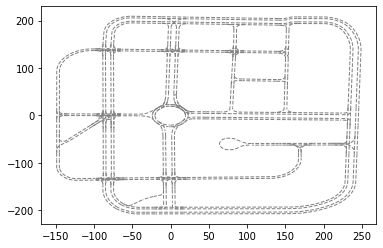

930048
None
rn id:  930049


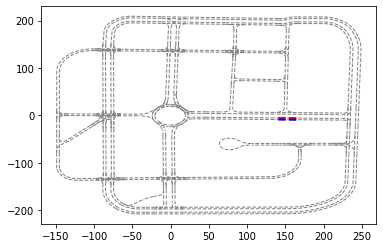

930227
None
rn id:  930228


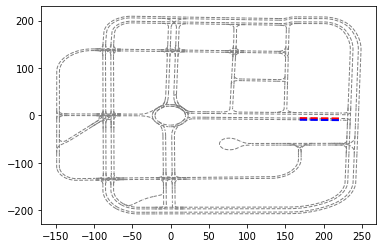

930264
None
rn id:  930265


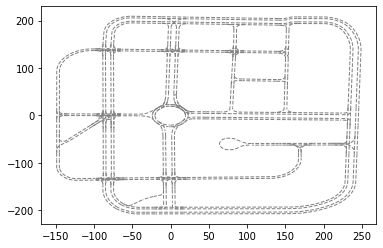

930055
None
None


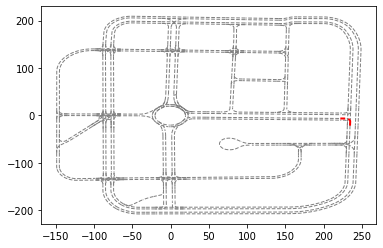

930049
ln id:  930048
None


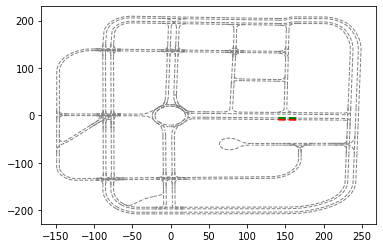

930228
ln id:  930227
None


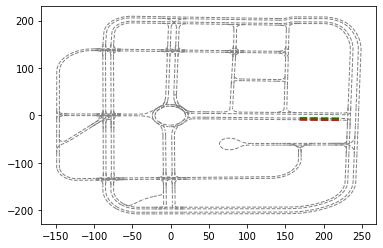

930265
ln id:  930264
None


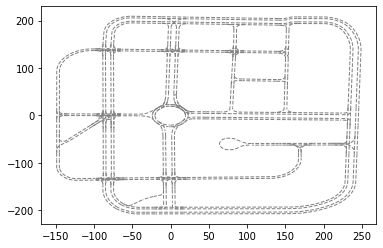

930351
None
None


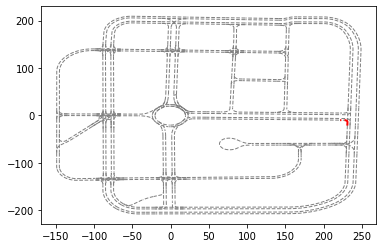

930056
None
rn id:  930057


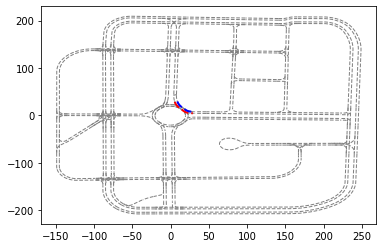

930057
ln id:  930056
None


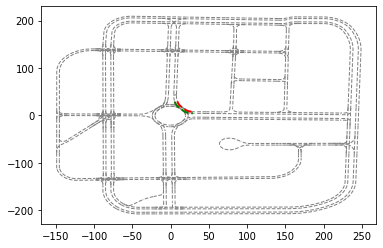

930080
None
rn id:  930079


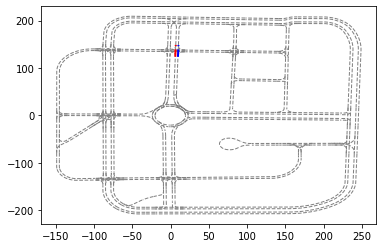

930108
None
rn id:  930109


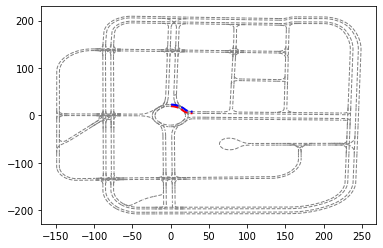

930109
ln id:  930108
None


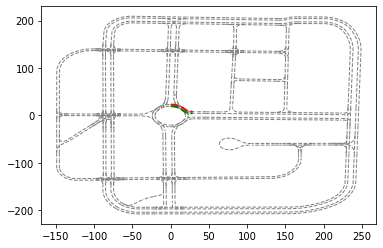

930128
None
None


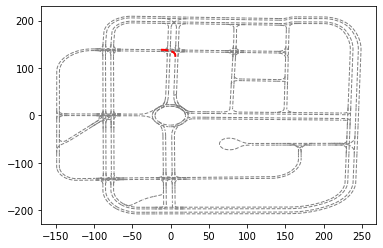

930165
None
rn id:  930166


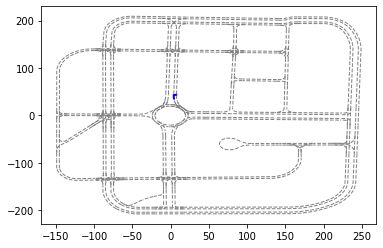

930268
None
rn id:  930267


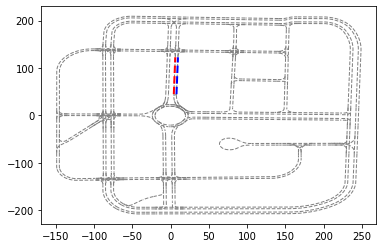

930188
None
rn id:  930189


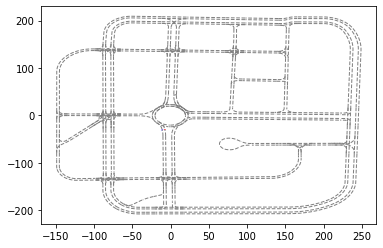

930370
None
rn id:  930371


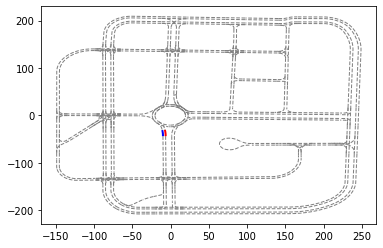

930278
None
rn id:  930277


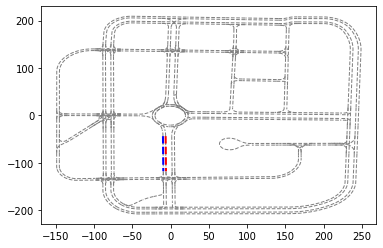

930254
None
None


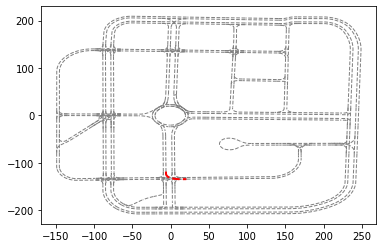

930344
None
rn id:  930343


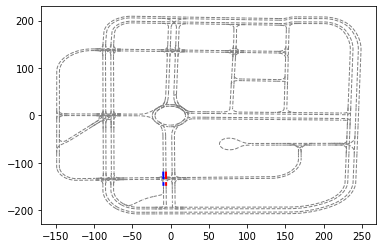

930189
ln id:  930188
None


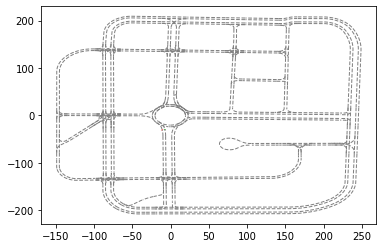

930371
ln id:  930370
None


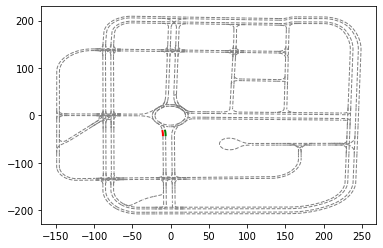

930277
ln id:  930278
None


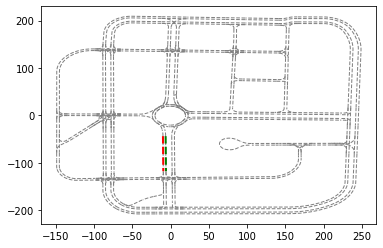

930343
ln id:  930344
None


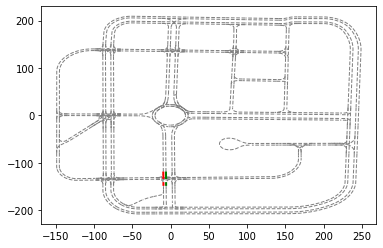

930229
None
None


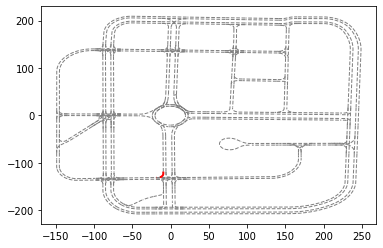

930195
ln id:  930196
None


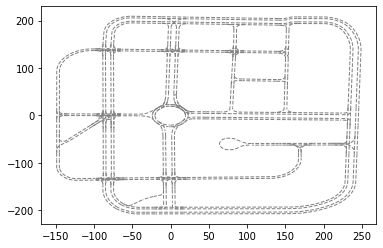

930196
None
rn id:  930195


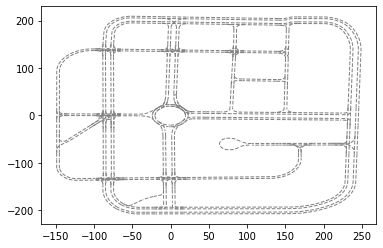

930232
None
rn id:  930233


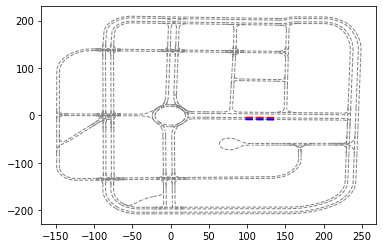

930233
ln id:  930232
None


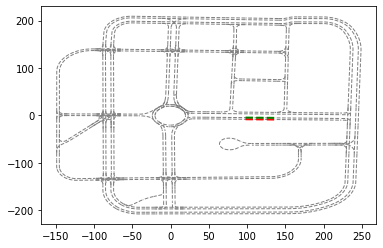

930236
None
rn id:  930237


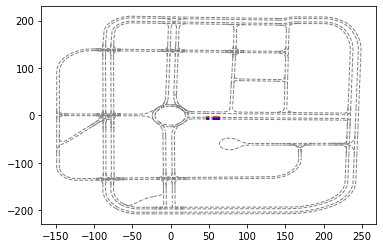

930366
None
rn id:  930367


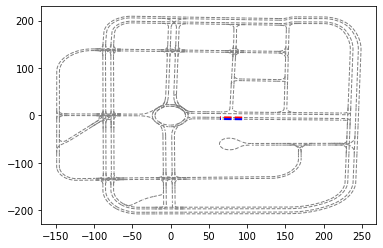

930237
ln id:  930236
None


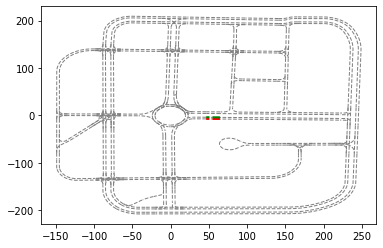

930367
ln id:  930366
None


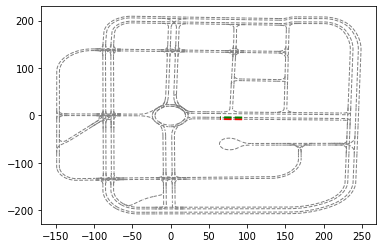

930292
None
rn id:  930293


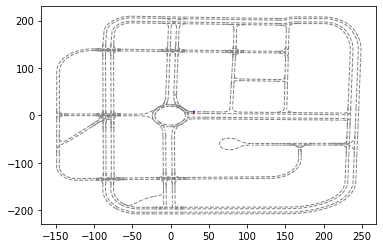

930293
ln id:  930292
None


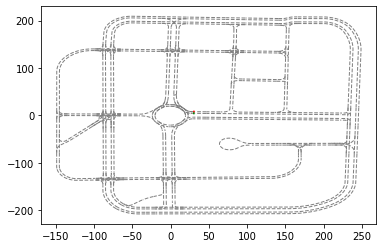

930338
None
rn id:  930339


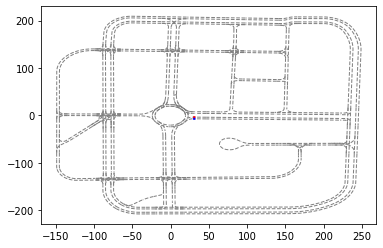

930397
None
rn id:  930398


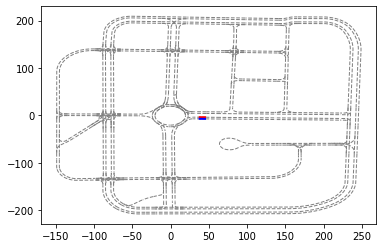

930339
ln id:  930338
None


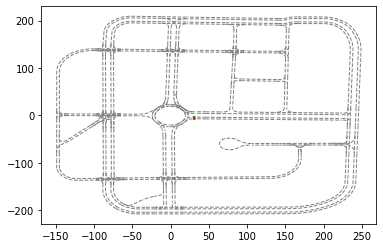

930398
ln id:  930397
None


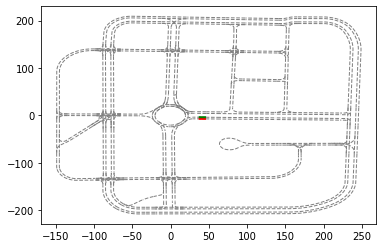

In [32]:
# left neighbor / right neighbor
ids = []
ln_ids = []
rn_ids = []

for lane_prop in lane_props:
    ids.append(lane_prop.id)
    ln_ids.append(lane_prop.l_neighbor_id)
    rn_ids.append(lane_prop.r_neighbor_id)
    
    
    
    
    
for i in range(len(suc_laneid)):
    plt.figure()
    
    for lane_prop in lane_props:
        lane_cl = lane_prop.centerline
        plt.plot(
            lane_cl[:, 0],
            -lane_cl[:, 1],
            "--",
            color="grey",
            alpha=1,
            linewidth=1,
            zorder=0,
            )
    
    
    for t in range(i+1):
        lane_id = suc_laneid[t]
        lane_cl = seq_lane_props[lane_id].centerline

        if t == i:
            plt.plot(
            lane_cl[:, 0],
            -lane_cl[:, 1],
            "--",
            color="red",
            alpha=1,
            linewidth=2,
            zorder=0,
            )
            print(lane_id)
            try:
                plt.plot(
                seq_lane_props[ln_ids[ids.index(lane_id)]].centerline[:, 0],
                -seq_lane_props[ln_ids[ids.index(lane_id)]].centerline[:, 1],
                "--",
                color="green",
                alpha=1,
                linewidth=2,
                zorder=0,
                )
                print('ln id: ', ln_ids[ids.index(lane_id)] )
#                 print(seq_lane_props[ln_ids[ids.index(lane_id)]].centerline)
            except Exception as e:
                print(e)
                pass

            try:
                plt.plot(
                seq_lane_props[rn_ids[ids.index(lane_id)]].centerline[:, 0],
                -seq_lane_props[rn_ids[ids.index(lane_id)]].centerline[:, 1],
                "--",
                color="blue",
                alpha=1,
                linewidth=2,
                zorder=0,
                )
                print('rn id: ', rn_ids[ids.index(lane_id)] )
#                 print(seq_lane_props[rn_ids[ids.index(lane_id)]].centerline)
            except Exception as e:
                print(e)
                pass
            
    plt.show()
    plt.close()
    
    


In [29]:
#near perfect

In [13]:
import torch

a = torch.Tensor([1,2,3])
b = torch.zeros([10])

In [18]:
a[b]

IndexError: tensors used as indices must be long, byte or bool tensors

In [17]:
b.shape

torch.Size([10])